# Explore Crosswalks

We extract scenes that contain a crosswalk and plot the front cameras and trajectory for each scene. 
A few scenes are specifically explored to understand cross-walk scenarios.

72 scenes are extracted.  Many contain trajectories where ego vehicle doens't move at all.

In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from nuscenes.nuscenes import NuScenes

import matplotlib.pyplot as plt
nusc = NuScenes(version='v1.0', dataroot='/home/noam/nuscenes/full_data_set', verbose=True)

Loading NuScenes tables for version v1.0...
23 category,
8 attribute,
4 visibility,
64386 instance,
12 sensor,
10200 calibrated_sensor,
2631083 ego_pose,
68 log,
850 scene,
34149 sample,
2631083 sample_data,
1166187 sample_annotation,
4 map,
Done loading in 36.5 seconds.
Reverse indexing ...
Done reverse indexing in 9.7 seconds.


### 1. `scene`

In [2]:
import nuscenes.utils.nb_utils as nbutils
scenes_with_crosswalk = nbutils.query_scenes_for_word(nusc, "crosswalk")

### Plot the Front Cameras for Those in Crosswalk

Scene 1/72.  Location: boston-seaport


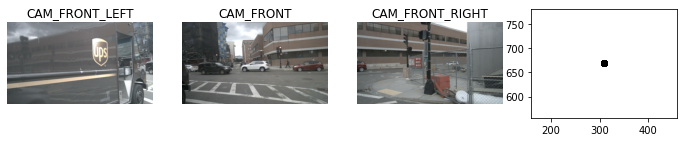

-----------------------------------------------------------------------------
Scene 2/72.  Location: boston-seaport


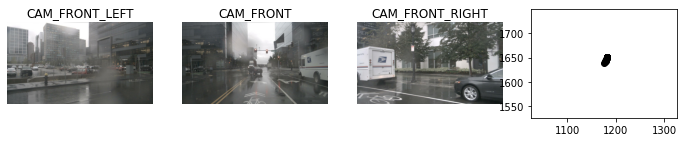

-----------------------------------------------------------------------------
Scene 3/72.  Location: boston-seaport


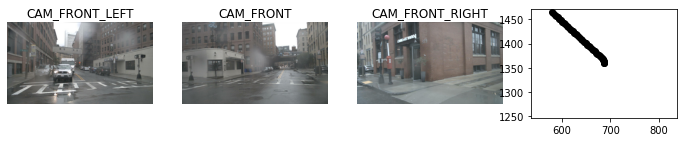

-----------------------------------------------------------------------------
Scene 4/72.  Location: singapore-queenstown


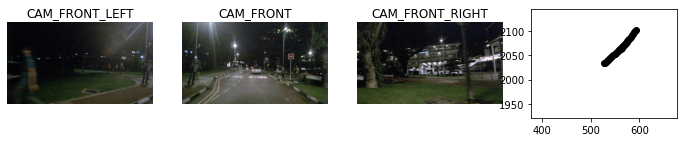

-----------------------------------------------------------------------------
Scene 5/72.  Location: singapore-queenstown


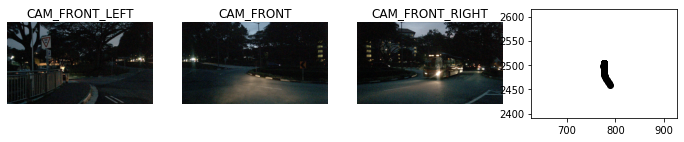

-----------------------------------------------------------------------------
Scene 6/72.  Location: boston-seaport


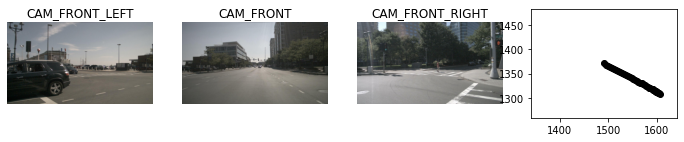

-----------------------------------------------------------------------------
Scene 7/72.  Location: boston-seaport


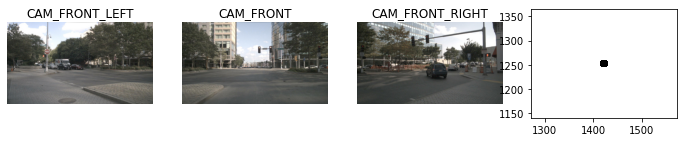

-----------------------------------------------------------------------------
Scene 8/72.  Location: boston-seaport


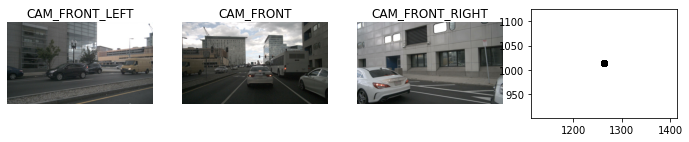

-----------------------------------------------------------------------------
Scene 9/72.  Location: boston-seaport


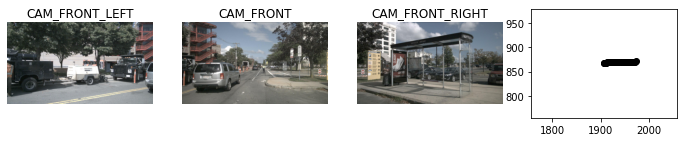

-----------------------------------------------------------------------------
Scene 10/72.  Location: boston-seaport


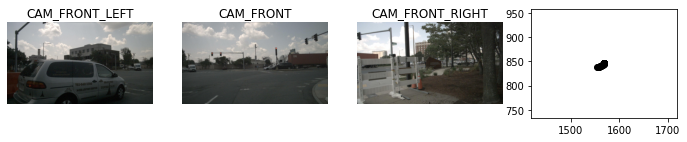

-----------------------------------------------------------------------------
Scene 11/72.  Location: singapore-queenstown


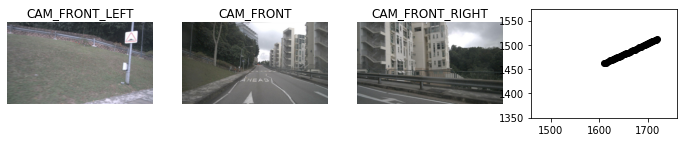

-----------------------------------------------------------------------------
Scene 12/72.  Location: boston-seaport


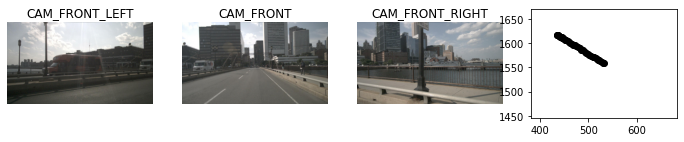

-----------------------------------------------------------------------------
Scene 13/72.  Location: boston-seaport


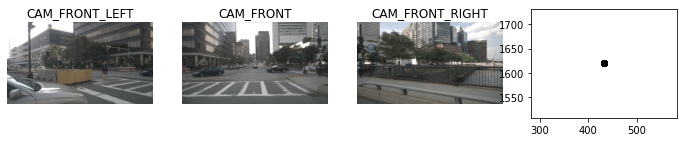

-----------------------------------------------------------------------------
Scene 14/72.  Location: boston-seaport


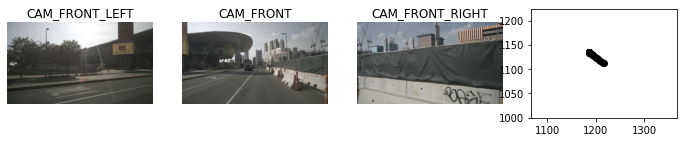

-----------------------------------------------------------------------------
Scene 15/72.  Location: boston-seaport


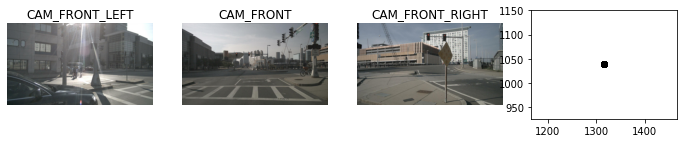

-----------------------------------------------------------------------------
Scene 16/72.  Location: singapore-onenorth


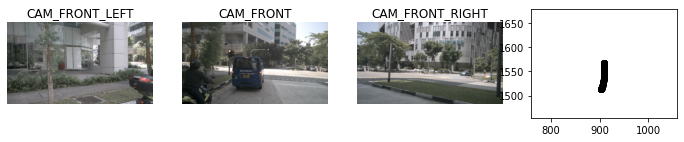

-----------------------------------------------------------------------------
Scene 17/72.  Location: singapore-hollandvillage


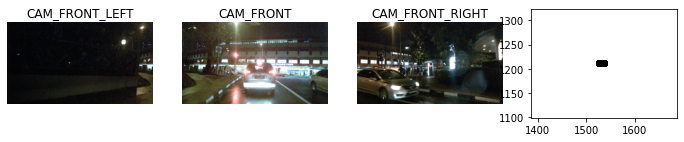

-----------------------------------------------------------------------------
Scene 18/72.  Location: boston-seaport


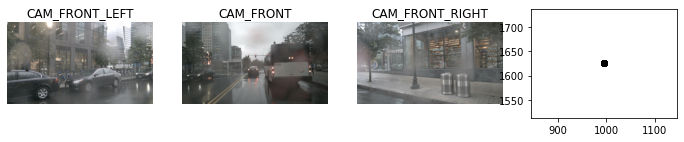

-----------------------------------------------------------------------------
Scene 19/72.  Location: boston-seaport


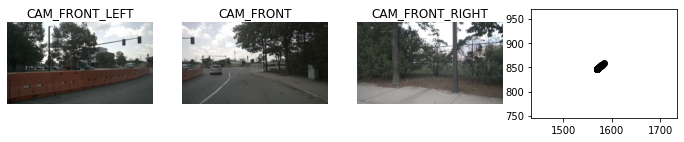

-----------------------------------------------------------------------------
Scene 20/72.  Location: boston-seaport


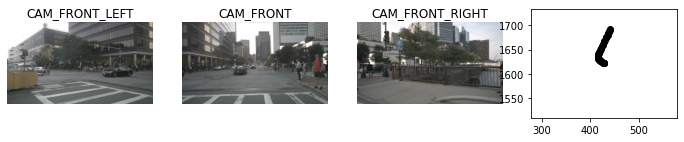

-----------------------------------------------------------------------------
Scene 21/72.  Location: singapore-queenstown


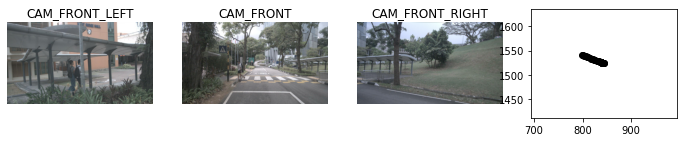

-----------------------------------------------------------------------------
Scene 22/72.  Location: singapore-onenorth


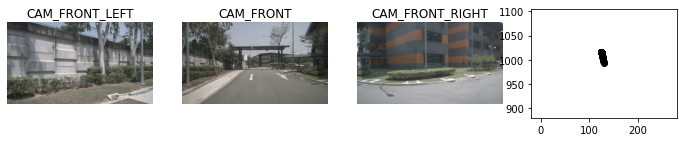

-----------------------------------------------------------------------------
Scene 23/72.  Location: boston-seaport


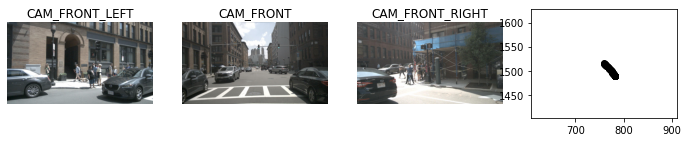

-----------------------------------------------------------------------------
Scene 24/72.  Location: singapore-hollandvillage


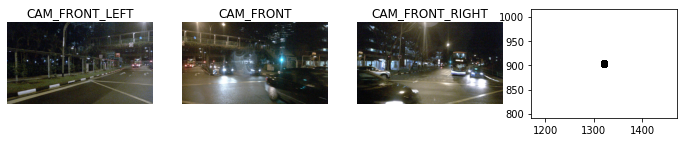

-----------------------------------------------------------------------------
Scene 25/72.  Location: boston-seaport


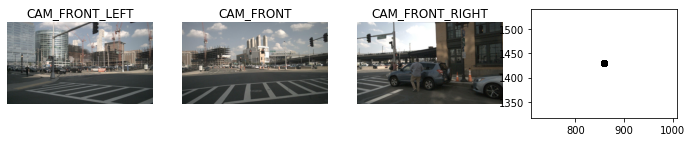

-----------------------------------------------------------------------------
Scene 26/72.  Location: singapore-queenstown


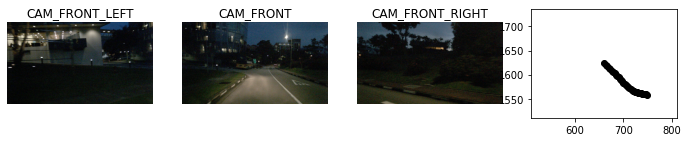

-----------------------------------------------------------------------------
Scene 27/72.  Location: boston-seaport


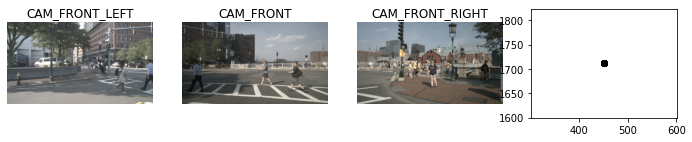

-----------------------------------------------------------------------------
Scene 28/72.  Location: boston-seaport


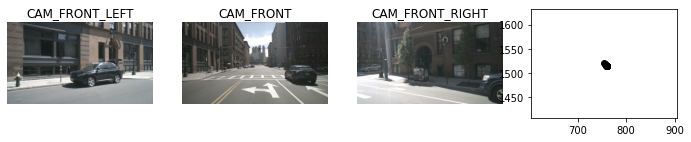

-----------------------------------------------------------------------------
Scene 29/72.  Location: boston-seaport


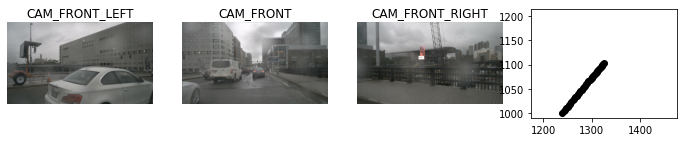

-----------------------------------------------------------------------------
Scene 30/72.  Location: boston-seaport


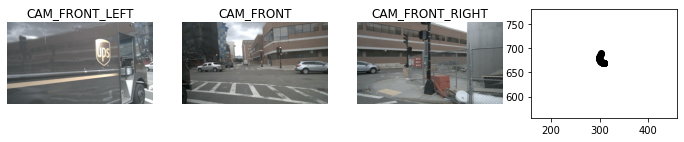

-----------------------------------------------------------------------------
Scene 31/72.  Location: singapore-onenorth


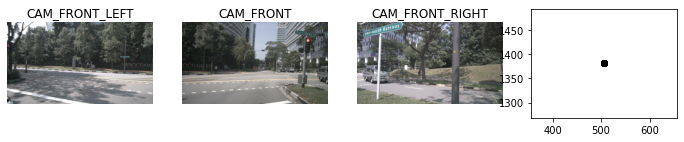

-----------------------------------------------------------------------------
Scene 32/72.  Location: singapore-onenorth


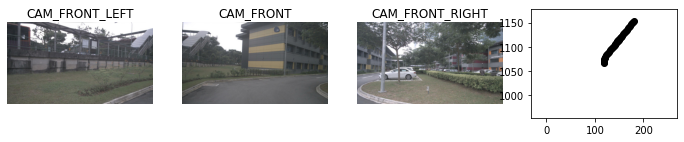

-----------------------------------------------------------------------------
Scene 33/72.  Location: singapore-onenorth


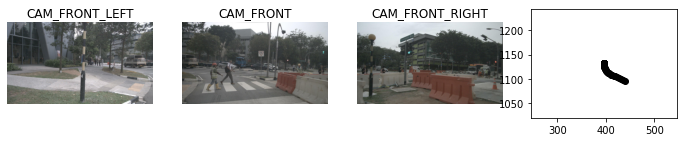

-----------------------------------------------------------------------------
Scene 34/72.  Location: boston-seaport


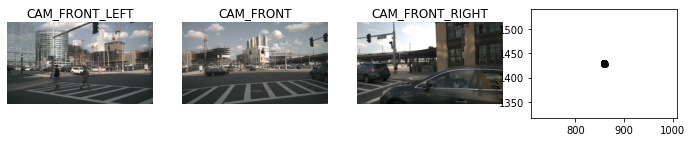

-----------------------------------------------------------------------------
Scene 35/72.  Location: boston-seaport


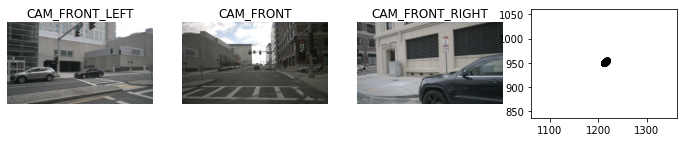

-----------------------------------------------------------------------------
Scene 36/72.  Location: boston-seaport


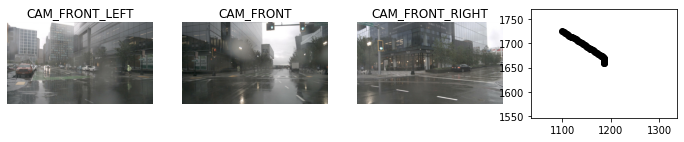

-----------------------------------------------------------------------------
Scene 37/72.  Location: boston-seaport


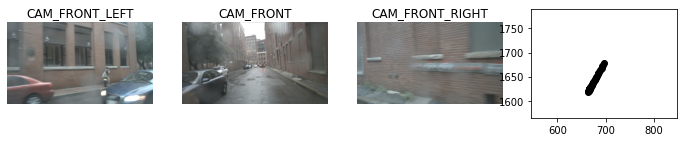

-----------------------------------------------------------------------------
Scene 38/72.  Location: singapore-queenstown


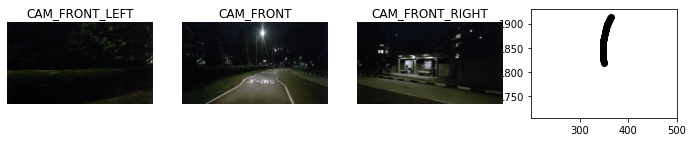

-----------------------------------------------------------------------------
Scene 39/72.  Location: singapore-onenorth


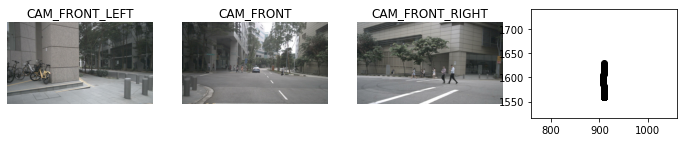

-----------------------------------------------------------------------------
Scene 40/72.  Location: boston-seaport


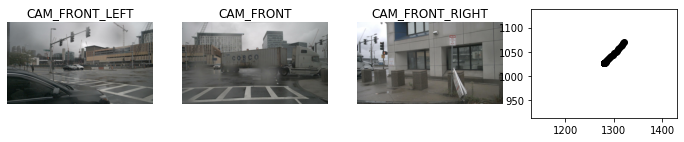

-----------------------------------------------------------------------------
Scene 41/72.  Location: singapore-onenorth


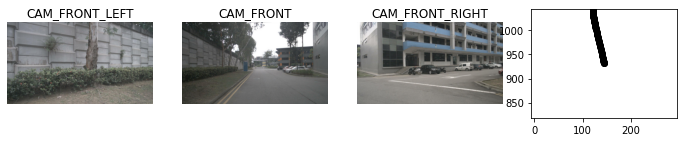

-----------------------------------------------------------------------------
Scene 42/72.  Location: boston-seaport


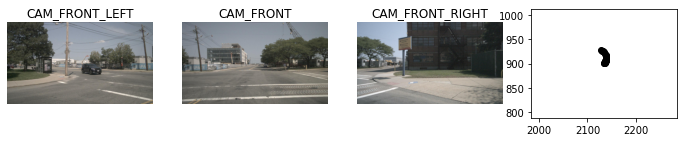

-----------------------------------------------------------------------------
Scene 43/72.  Location: boston-seaport


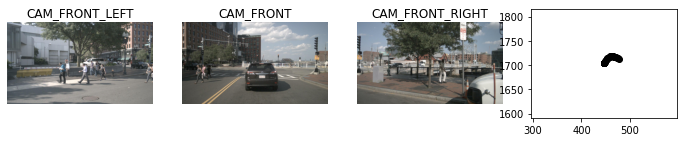

-----------------------------------------------------------------------------
Scene 44/72.  Location: boston-seaport


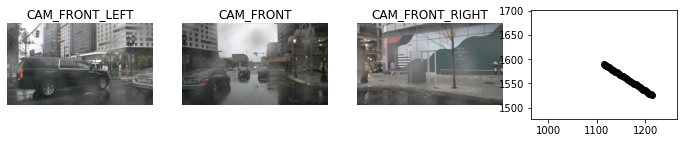

-----------------------------------------------------------------------------
Scene 45/72.  Location: boston-seaport


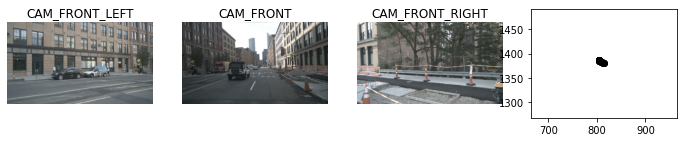

-----------------------------------------------------------------------------
Scene 46/72.  Location: singapore-queenstown


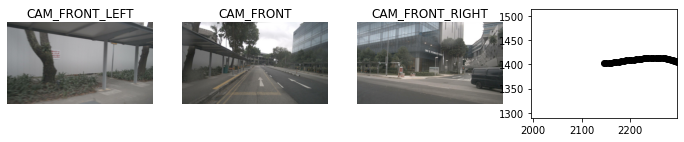

-----------------------------------------------------------------------------
Scene 47/72.  Location: singapore-onenorth


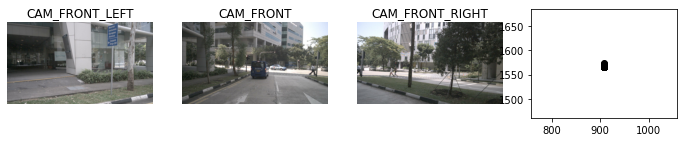

-----------------------------------------------------------------------------
Scene 48/72.  Location: boston-seaport


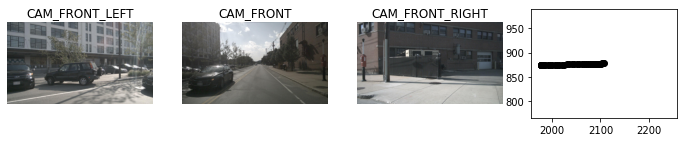

-----------------------------------------------------------------------------
Scene 49/72.  Location: boston-seaport


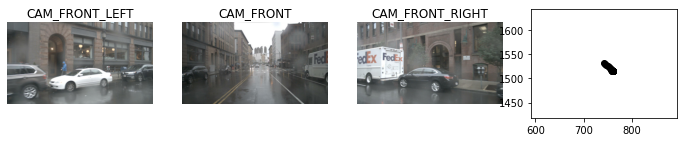

-----------------------------------------------------------------------------
Scene 50/72.  Location: singapore-hollandvillage


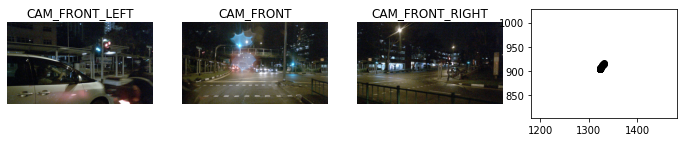

-----------------------------------------------------------------------------
Scene 51/72.  Location: boston-seaport


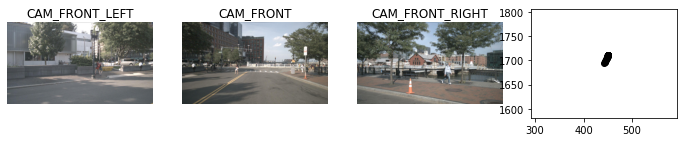

-----------------------------------------------------------------------------
Scene 52/72.  Location: boston-seaport


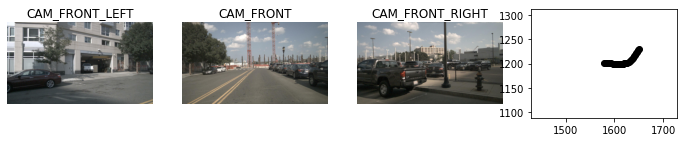

-----------------------------------------------------------------------------
Scene 53/72.  Location: boston-seaport


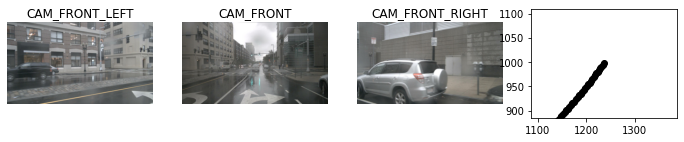

-----------------------------------------------------------------------------
Scene 54/72.  Location: boston-seaport


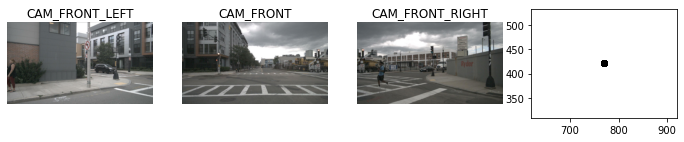

-----------------------------------------------------------------------------
Scene 55/72.  Location: singapore-onenorth


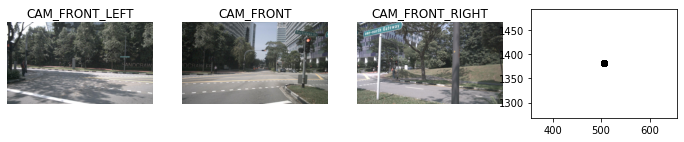

-----------------------------------------------------------------------------
Scene 56/72.  Location: singapore-onenorth


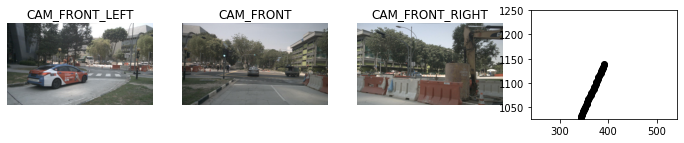

-----------------------------------------------------------------------------
Scene 57/72.  Location: singapore-hollandvillage


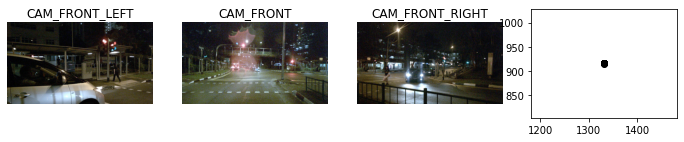

-----------------------------------------------------------------------------
Scene 58/72.  Location: boston-seaport


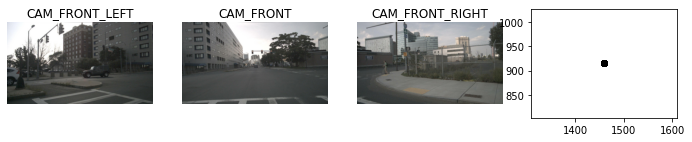

-----------------------------------------------------------------------------
Scene 59/72.  Location: boston-seaport


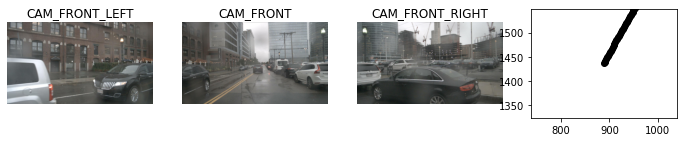

-----------------------------------------------------------------------------
Scene 60/72.  Location: singapore-queenstown


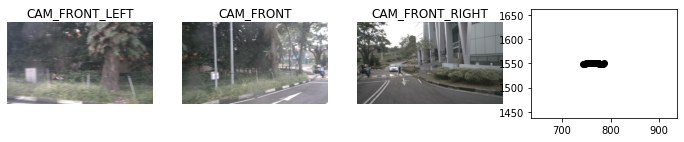

-----------------------------------------------------------------------------
Scene 61/72.  Location: singapore-onenorth


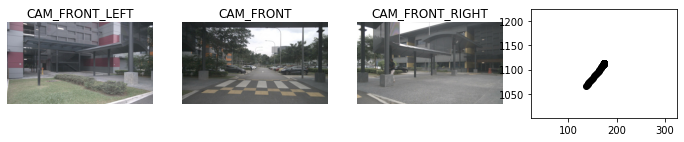

-----------------------------------------------------------------------------
Scene 62/72.  Location: boston-seaport


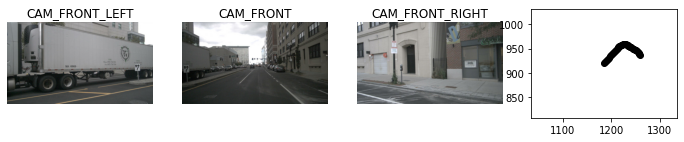

-----------------------------------------------------------------------------
Scene 63/72.  Location: boston-seaport


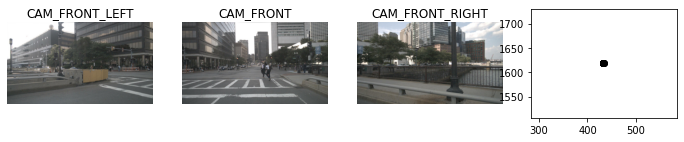

-----------------------------------------------------------------------------
Scene 64/72.  Location: boston-seaport


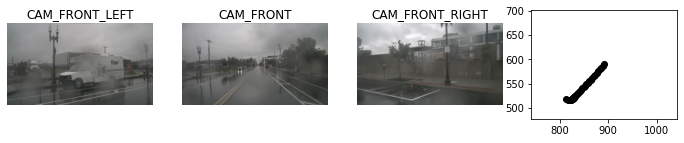

-----------------------------------------------------------------------------
Scene 65/72.  Location: boston-seaport


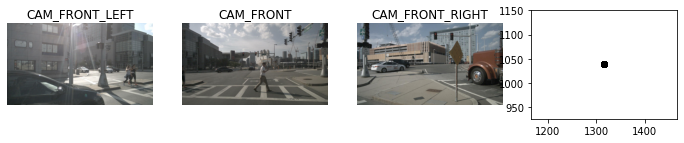

-----------------------------------------------------------------------------
Scene 66/72.  Location: boston-seaport


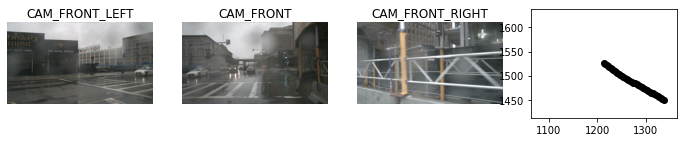

-----------------------------------------------------------------------------
Scene 67/72.  Location: singapore-queenstown


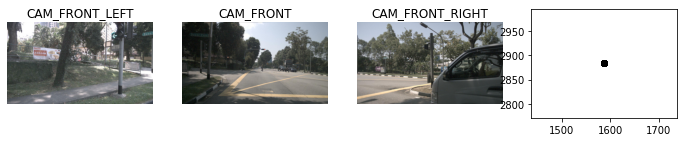

-----------------------------------------------------------------------------
Scene 68/72.  Location: boston-seaport


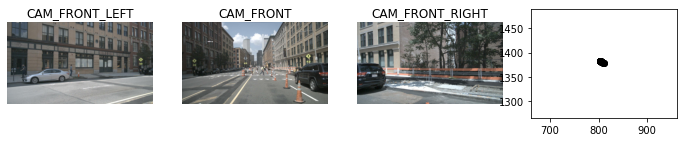

-----------------------------------------------------------------------------
Scene 69/72.  Location: boston-seaport


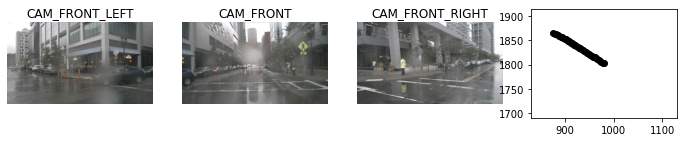

-----------------------------------------------------------------------------
Scene 70/72.  Location: boston-seaport


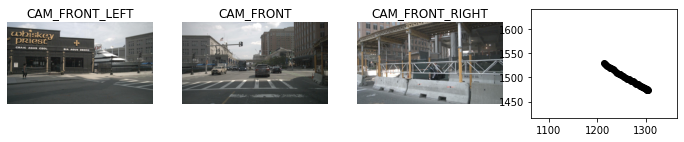

-----------------------------------------------------------------------------
Scene 71/72.  Location: boston-seaport


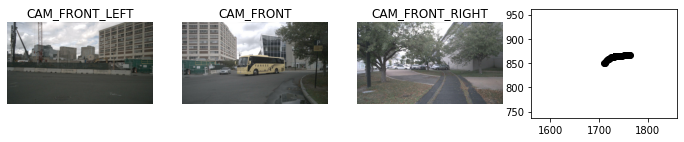

-----------------------------------------------------------------------------
Scene 72/72.  Location: boston-seaport


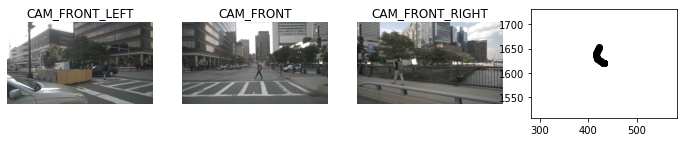

-----------------------------------------------------------------------------


In [6]:
scene_counter = 0
number_scenes = len(scenes_with_crosswalk)
number_views = 3
for scene_token in scenes_with_crosswalk:
    scene_counter += 1
    scene = nusc.get('scene', scene_token)
    location = nusc.get('log',scene['log_token'])['location']    
    sample = nusc.get('sample', scene['first_sample_token'])
    sensor = 'CAM_FRONT'
    
    cam_front_data = nusc.get('sample_data', sample['data'][sensor])
    cam_fright_data = nusc.get('sample_data', sample['data']['CAM_FRONT_RIGHT'])
    cam_fleft_data = nusc.get('sample_data', sample['data']['CAM_FRONT_LEFT'])
    
    print("Scene %d/%d.  Location: %s"%(scene_counter, number_scenes, location))
    fig, axs = plt.subplots(1, 4, figsize=[12,2])
    nusc.render_sample_data(cam_fleft_data['token'], with_anns=False, ax = axs[0])
    nusc.render_sample_data(cam_front_data['token'], with_anns=False, ax = axs[1])
    nusc.render_sample_data(cam_fright_data['token'], with_anns=False, ax = axs[2])
    pose_array = nbutils.get_ego_positions_from_scene(nusc, scene)
    axs[3].scatter(pose_array[0,:], pose_array[1,:], color='black')
    axs[3].axis('equal')
    axs[3].set_xlim([pose_array[0,0]-150,pose_array[0,0]+150])
    axs[3].set_ylim([pose_array[1,0]-150,pose_array[1,0]+150])
    
#     plt.scatter(pose_array[0,sample_counter-1], pose_array[1,sample_counter-1],color='red')
    plt.show()
    print("-----------------------------------------------------------------------------")
    

Scene 1/72.  Location: singapore-onenorth


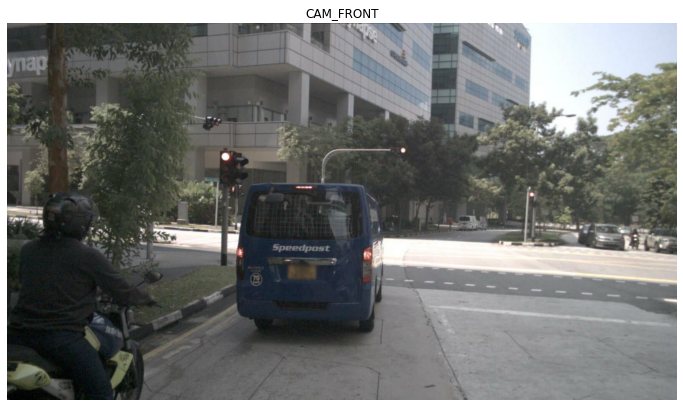

-----------------------------------------------------------------------------
Scene 2/72.  Location: boston-seaport


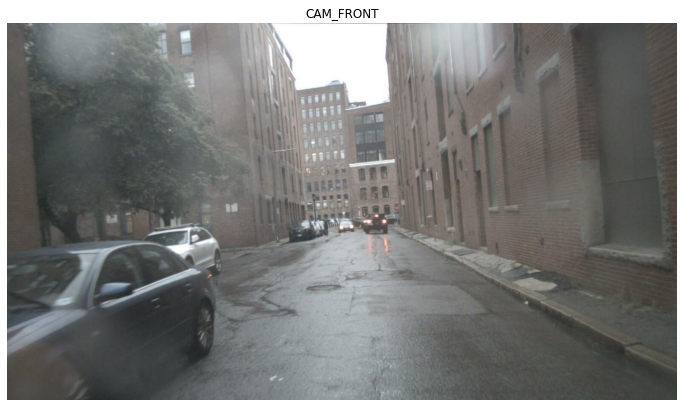

-----------------------------------------------------------------------------
Scene 3/72.  Location: boston-seaport


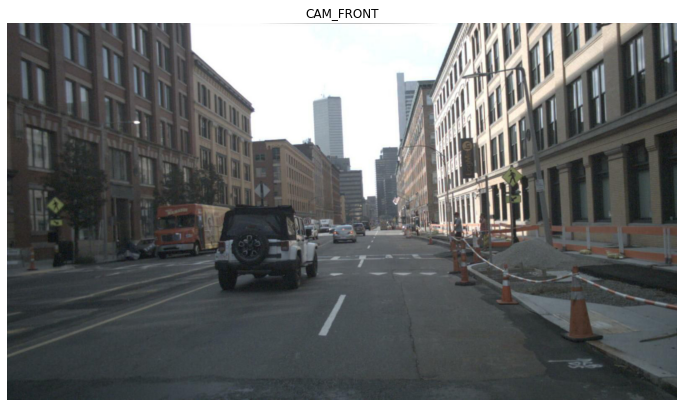

-----------------------------------------------------------------------------
Scene 4/72.  Location: singapore-onenorth


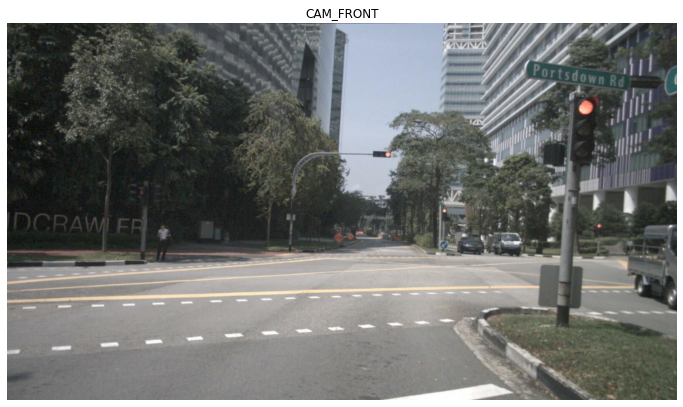

-----------------------------------------------------------------------------
Scene 5/72.  Location: singapore-hollandvillage


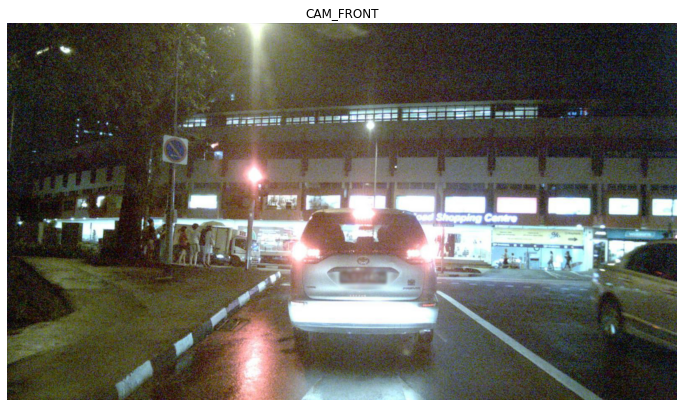

-----------------------------------------------------------------------------
Scene 6/72.  Location: boston-seaport


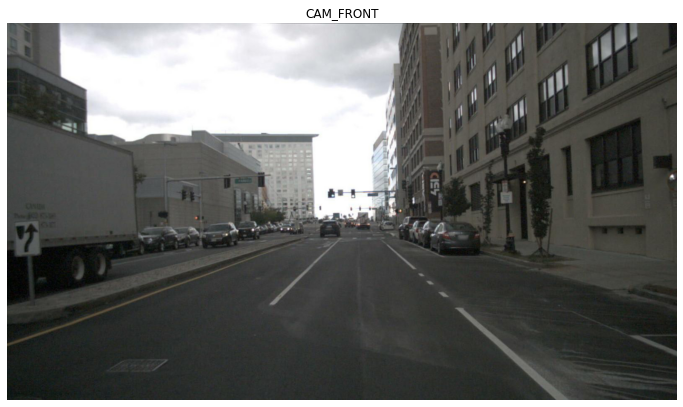

-----------------------------------------------------------------------------
Scene 7/72.  Location: boston-seaport


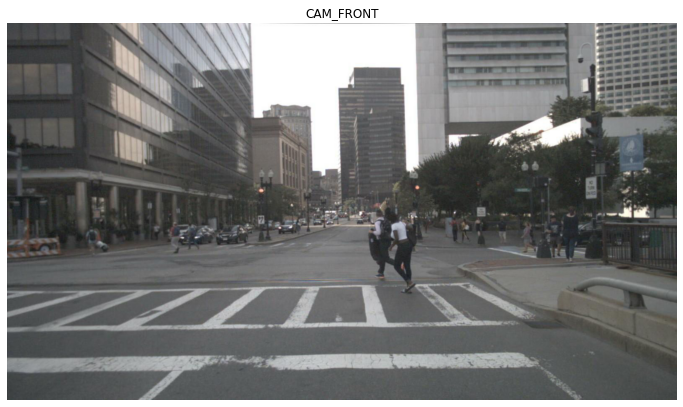

-----------------------------------------------------------------------------
Scene 8/72.  Location: boston-seaport


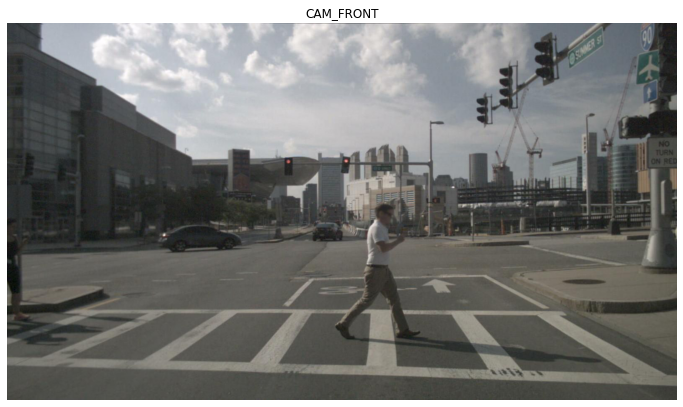

-----------------------------------------------------------------------------
Scene 9/72.  Location: singapore-queenstown


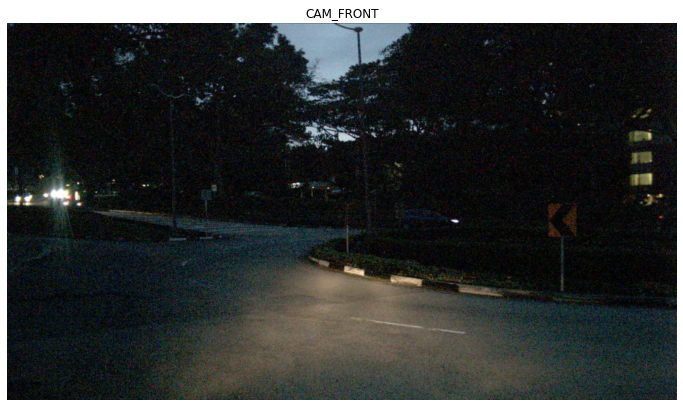

-----------------------------------------------------------------------------
Scene 10/72.  Location: boston-seaport


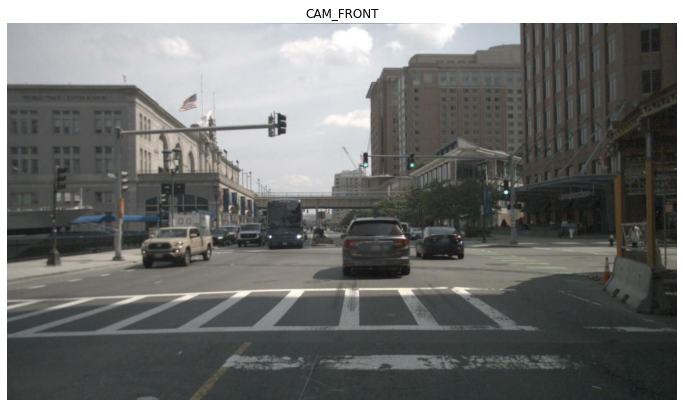

-----------------------------------------------------------------------------
Scene 11/72.  Location: singapore-queenstown


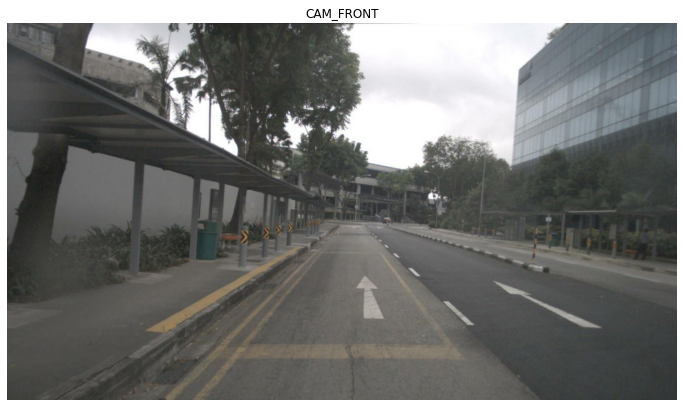

-----------------------------------------------------------------------------
Scene 12/72.  Location: boston-seaport


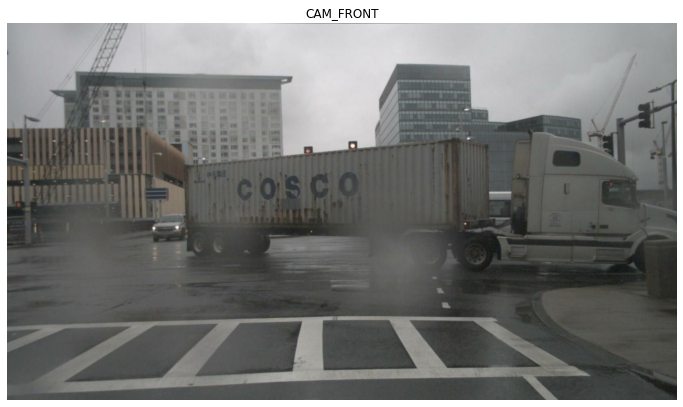

-----------------------------------------------------------------------------
Scene 13/72.  Location: boston-seaport


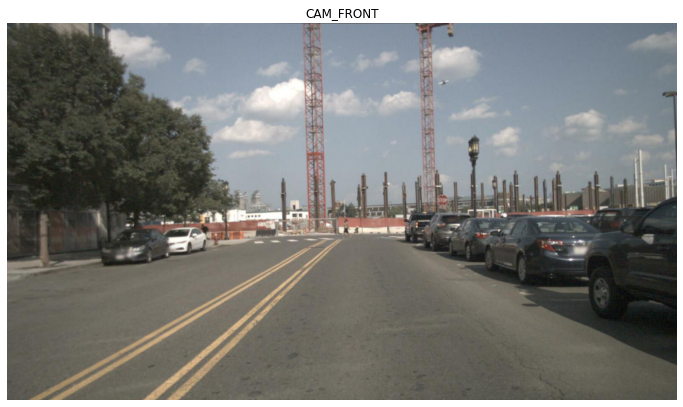

-----------------------------------------------------------------------------
Scene 14/72.  Location: boston-seaport


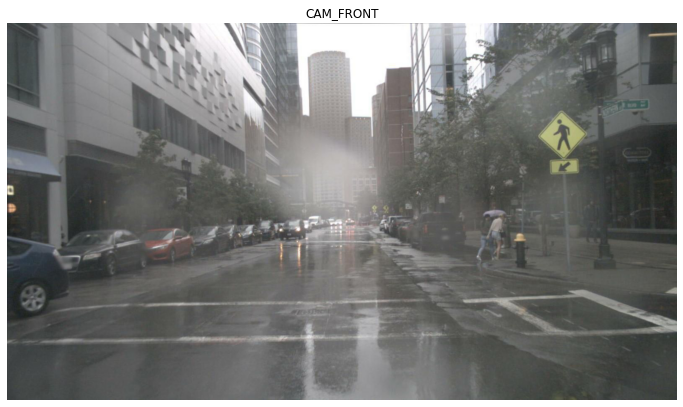

-----------------------------------------------------------------------------
Scene 15/72.  Location: boston-seaport


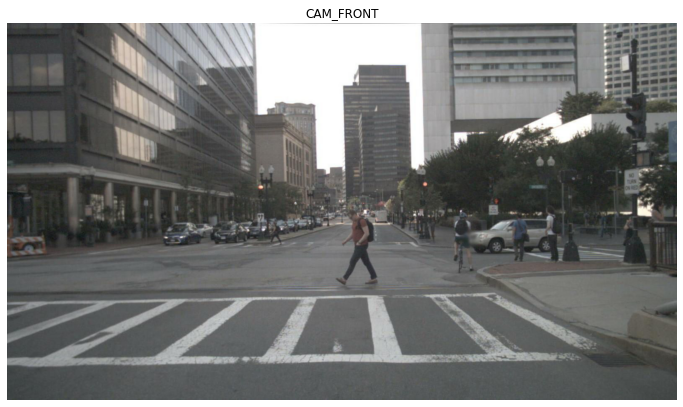

-----------------------------------------------------------------------------
Scene 16/72.  Location: boston-seaport


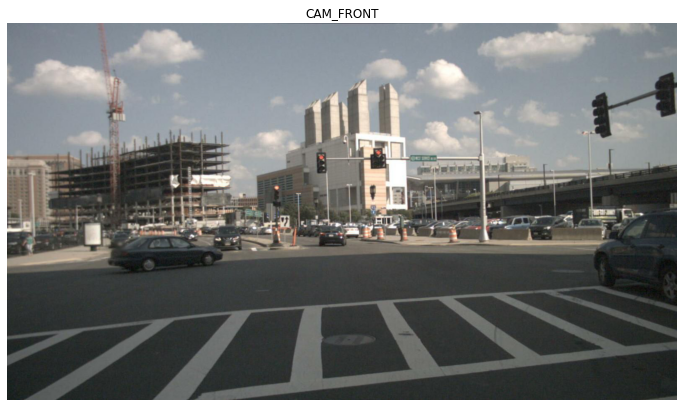

-----------------------------------------------------------------------------
Scene 17/72.  Location: boston-seaport


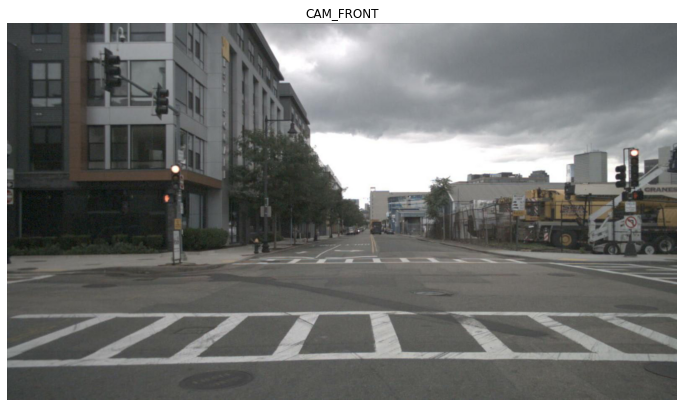

-----------------------------------------------------------------------------
Scene 18/72.  Location: boston-seaport


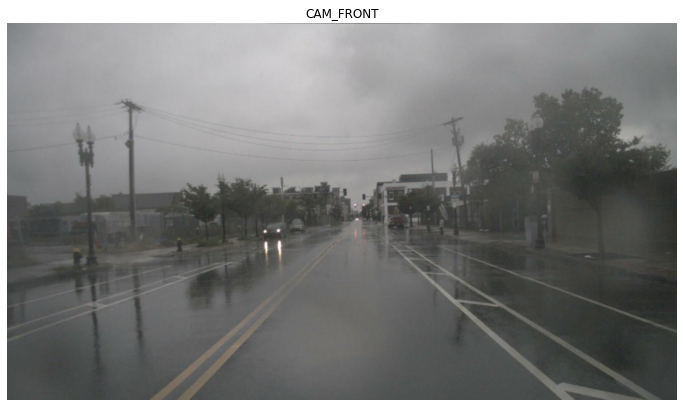

-----------------------------------------------------------------------------
Scene 19/72.  Location: singapore-onenorth


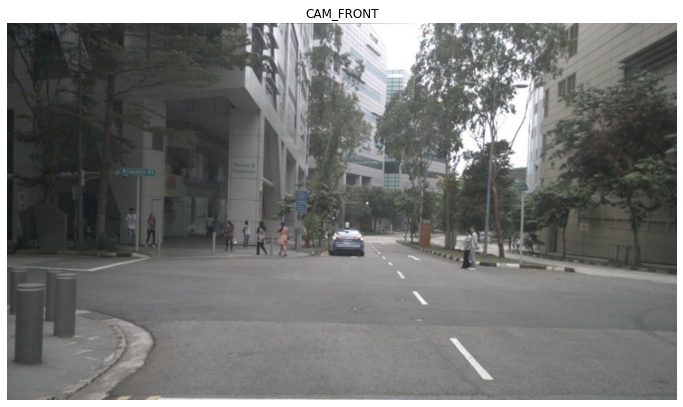

-----------------------------------------------------------------------------
Scene 20/72.  Location: boston-seaport


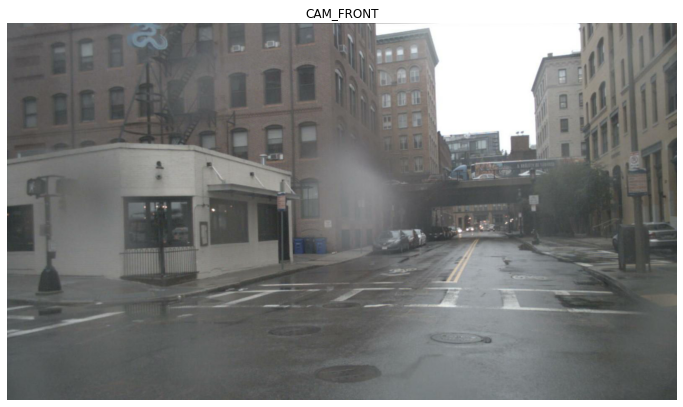

-----------------------------------------------------------------------------
Scene 21/72.  Location: singapore-hollandvillage


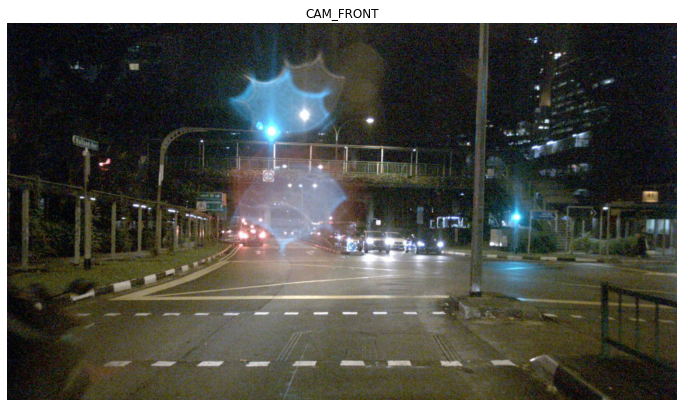

-----------------------------------------------------------------------------
Scene 22/72.  Location: boston-seaport


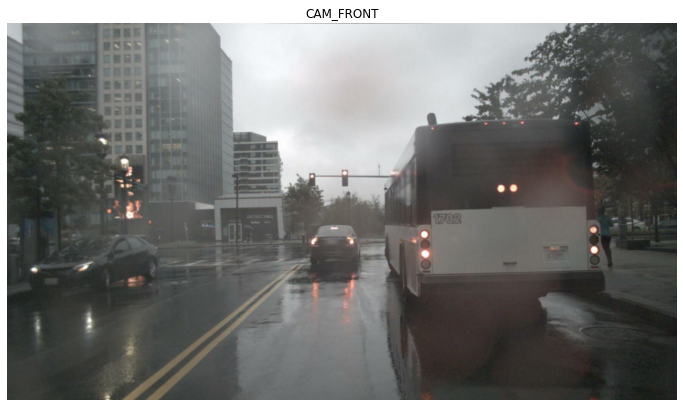

-----------------------------------------------------------------------------
Scene 23/72.  Location: boston-seaport


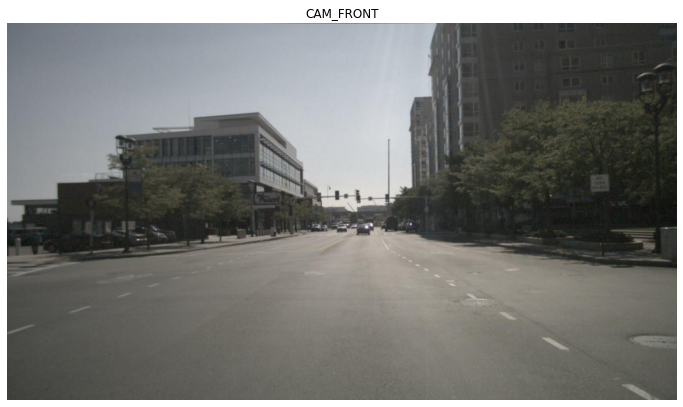

-----------------------------------------------------------------------------
Scene 24/72.  Location: boston-seaport


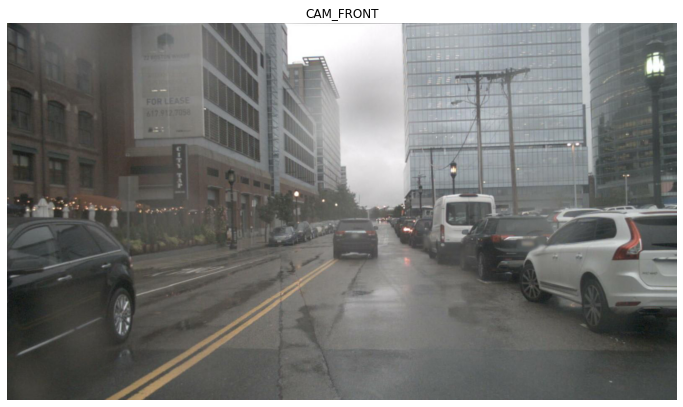

-----------------------------------------------------------------------------
Scene 25/72.  Location: boston-seaport


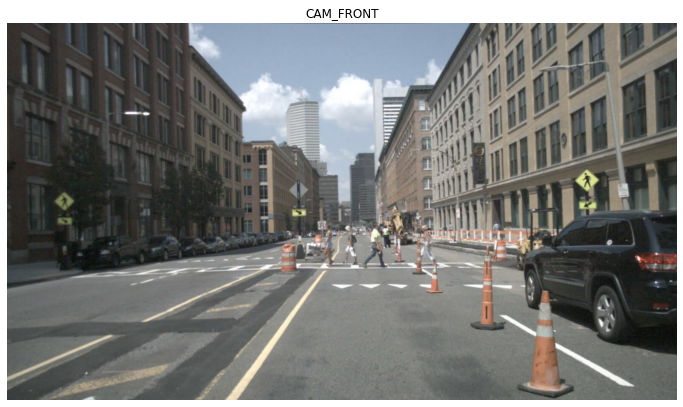

-----------------------------------------------------------------------------
Scene 26/72.  Location: boston-seaport


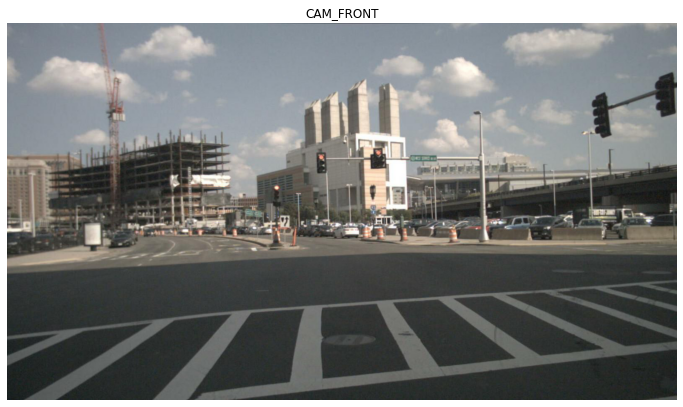

-----------------------------------------------------------------------------
Scene 27/72.  Location: boston-seaport


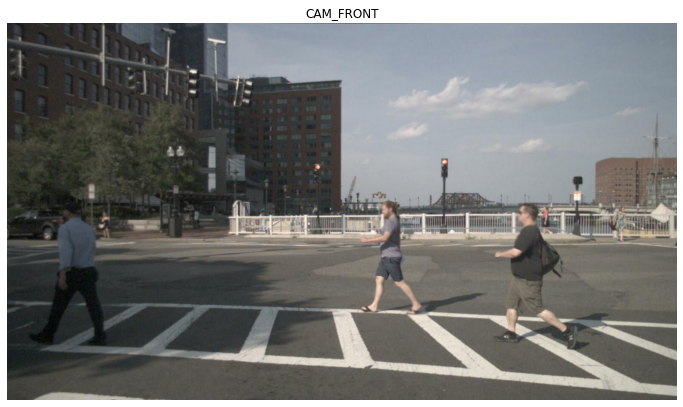

-----------------------------------------------------------------------------
Scene 28/72.  Location: boston-seaport


KeyboardInterrupt: 

In [8]:
scene_counter = 0
number_scenes = len(scenes_with_crosswalk)
for scene_token in scenes_with_crosswalk:
    scene_counter += 1
    scene = nusc.get('scene', scene_token)
    location = nusc.get('log',scene['log_token'])['location']    
    sample = nusc.get('sample', scene['first_sample_token'])
    sensor = 'CAM_FRONT'
    
    cam_front_data = nusc.get('sample_data', sample['data'][sensor])
    cam_fright_data = nusc.get('sample_data', sample['data']['CAM_FRONT_RIGHT'])
    cam_fleft_data = nusc.get('sample_data', sample['data']['CAM_FRONT_LEFT'])
    
    print("Scene %d/%d.  Location: %s"%(scene_counter, number_scenes, location))
    fig, axs = plt.subplots(1, 1, figsize=[12,8])
#     nusc.render_sample_data(cam_fleft_data['token'], with_anns=False, ax = axs[0])
    nusc.render_sample_data(cam_front_data['token'], with_anns=False, ax = axs)
#     nusc.render_sample_data(cam_fright_data['token'], with_anns=False, ax = axs[2])
    plt.show()
    print("-----------------------------------------------------------------------------")
    

### Explore A Boston Scene

Sample 1/40.  Location: boston-seaport


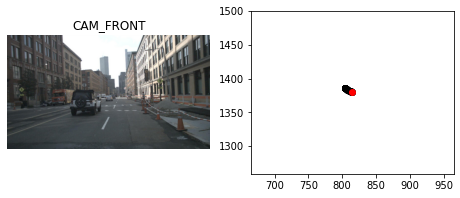

-----------------------------------------------------------------------------
Sample 2/40.  Location: boston-seaport


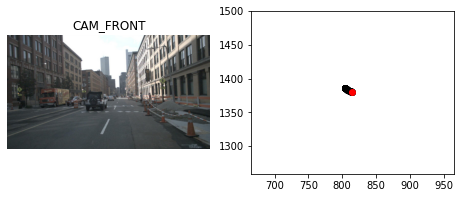

-----------------------------------------------------------------------------
Sample 3/40.  Location: boston-seaport


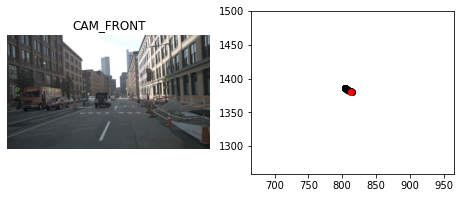

-----------------------------------------------------------------------------
Sample 4/40.  Location: boston-seaport


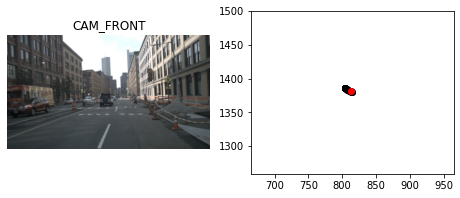

-----------------------------------------------------------------------------
Sample 5/40.  Location: boston-seaport


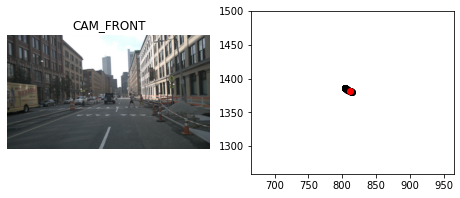

-----------------------------------------------------------------------------
Sample 6/40.  Location: boston-seaport


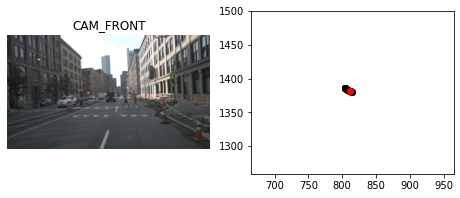

-----------------------------------------------------------------------------
Sample 7/40.  Location: boston-seaport


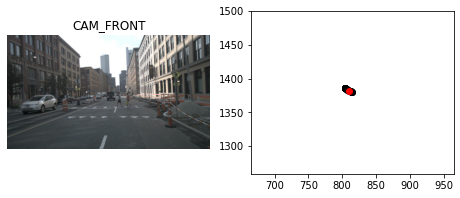

-----------------------------------------------------------------------------
Sample 8/40.  Location: boston-seaport


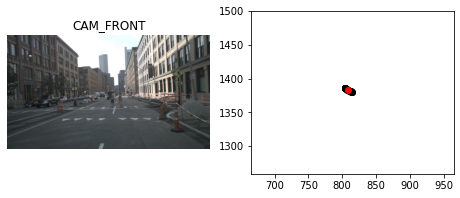

-----------------------------------------------------------------------------
Sample 9/40.  Location: boston-seaport


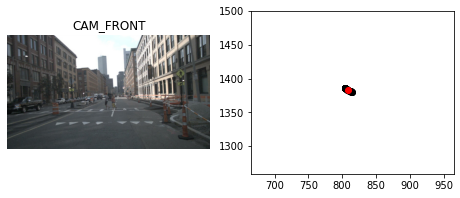

-----------------------------------------------------------------------------
Sample 10/40.  Location: boston-seaport


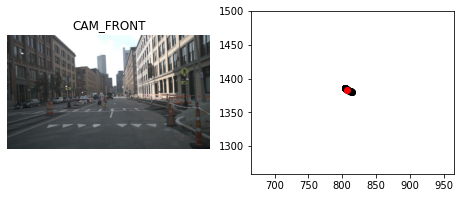

-----------------------------------------------------------------------------
Sample 11/40.  Location: boston-seaport


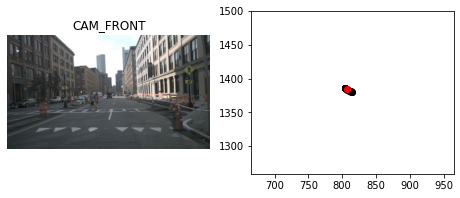

-----------------------------------------------------------------------------
Sample 12/40.  Location: boston-seaport


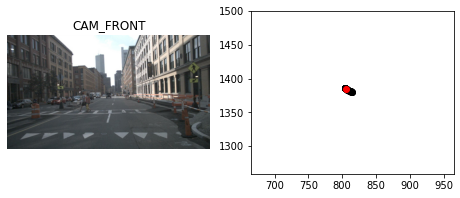

-----------------------------------------------------------------------------
Sample 13/40.  Location: boston-seaport


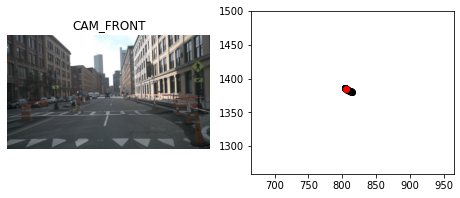

-----------------------------------------------------------------------------
Sample 14/40.  Location: boston-seaport


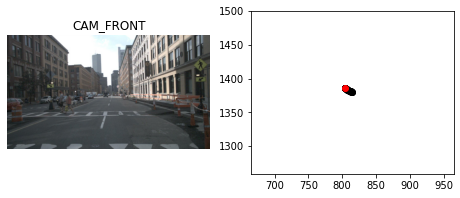

-----------------------------------------------------------------------------
Sample 15/40.  Location: boston-seaport


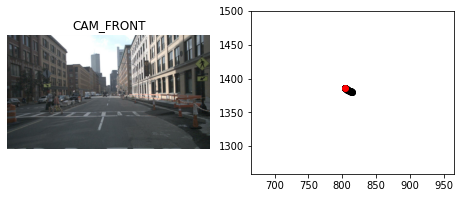

-----------------------------------------------------------------------------
Sample 16/40.  Location: boston-seaport


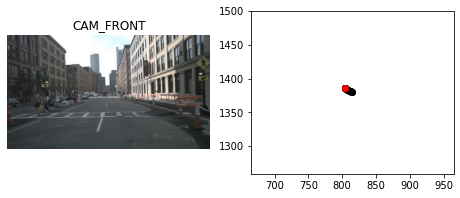

-----------------------------------------------------------------------------
Sample 17/40.  Location: boston-seaport


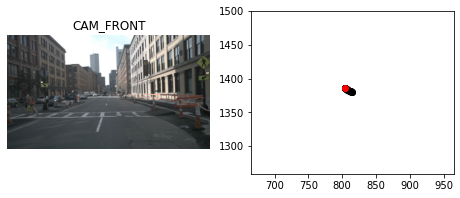

-----------------------------------------------------------------------------
Sample 18/40.  Location: boston-seaport


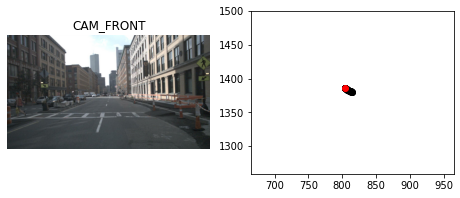

-----------------------------------------------------------------------------
Sample 19/40.  Location: boston-seaport


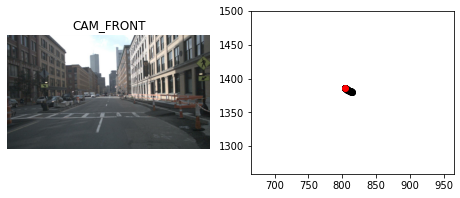

-----------------------------------------------------------------------------
Sample 20/40.  Location: boston-seaport


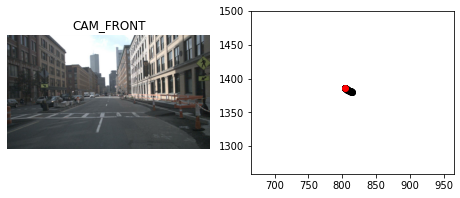

-----------------------------------------------------------------------------
Sample 21/40.  Location: boston-seaport


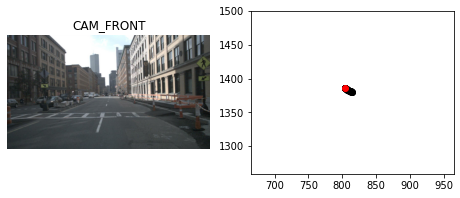

-----------------------------------------------------------------------------
Sample 22/40.  Location: boston-seaport


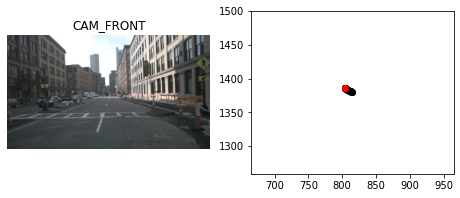

-----------------------------------------------------------------------------
Sample 23/40.  Location: boston-seaport


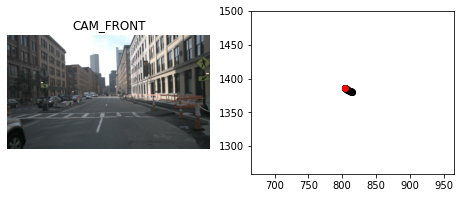

-----------------------------------------------------------------------------
Sample 24/40.  Location: boston-seaport


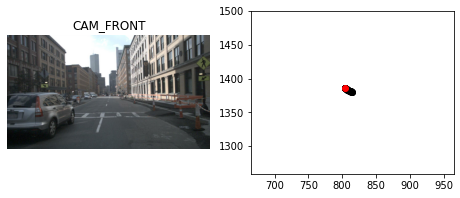

-----------------------------------------------------------------------------
Sample 25/40.  Location: boston-seaport


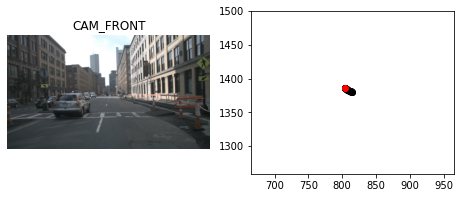

-----------------------------------------------------------------------------
Sample 26/40.  Location: boston-seaport


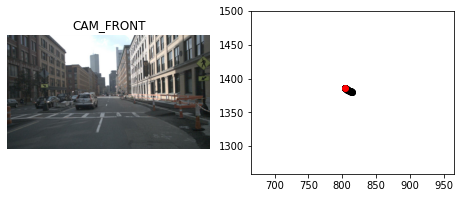

-----------------------------------------------------------------------------
Sample 27/40.  Location: boston-seaport


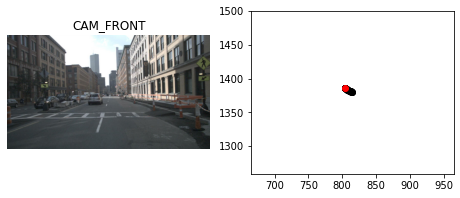

-----------------------------------------------------------------------------
Sample 28/40.  Location: boston-seaport


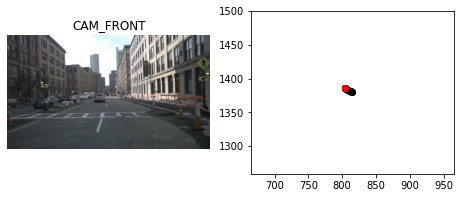

-----------------------------------------------------------------------------
Sample 29/40.  Location: boston-seaport


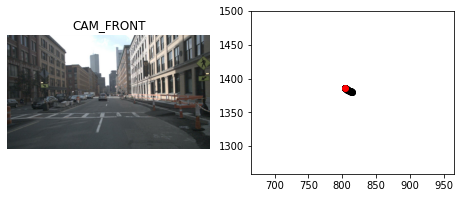

-----------------------------------------------------------------------------
Sample 30/40.  Location: boston-seaport


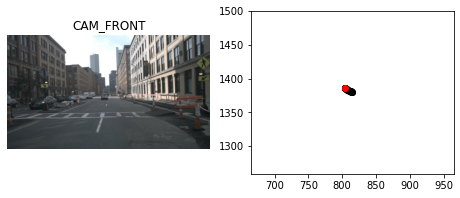

-----------------------------------------------------------------------------
Sample 31/40.  Location: boston-seaport


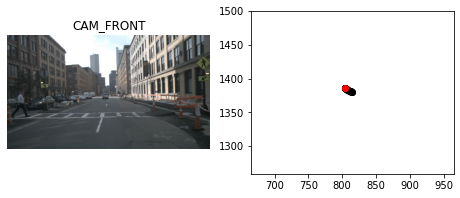

-----------------------------------------------------------------------------
Sample 32/40.  Location: boston-seaport


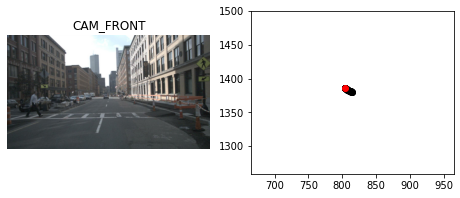

-----------------------------------------------------------------------------
Sample 33/40.  Location: boston-seaport


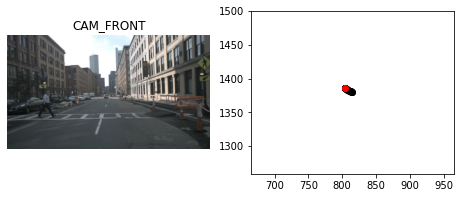

-----------------------------------------------------------------------------
Sample 34/40.  Location: boston-seaport


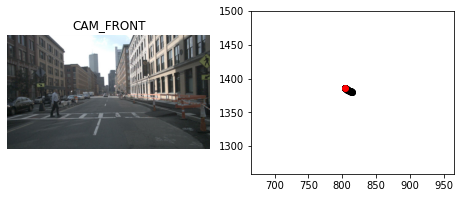

-----------------------------------------------------------------------------
Sample 35/40.  Location: boston-seaport


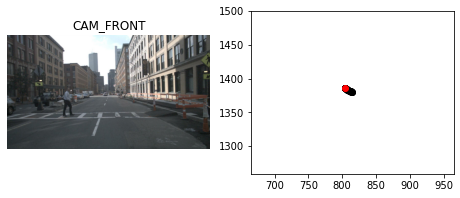

-----------------------------------------------------------------------------
Sample 36/40.  Location: boston-seaport


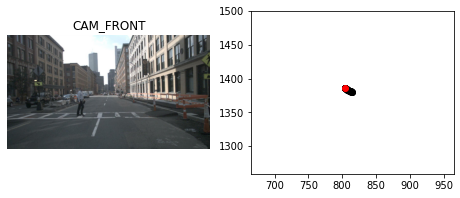

-----------------------------------------------------------------------------
Sample 37/40.  Location: boston-seaport


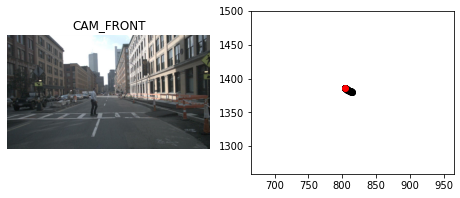

-----------------------------------------------------------------------------
Sample 38/40.  Location: boston-seaport


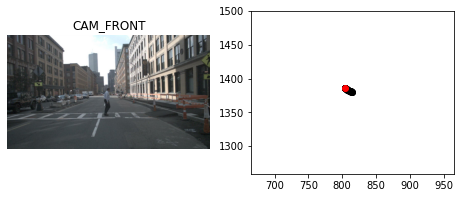

-----------------------------------------------------------------------------
Sample 39/40.  Location: boston-seaport


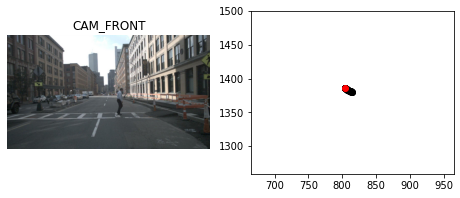

-----------------------------------------------------------------------------
Sample 40/40.  Location: boston-seaport


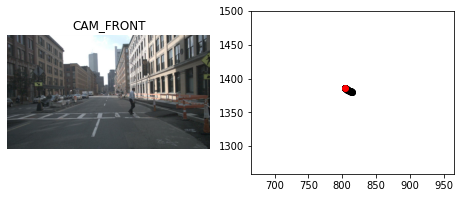

-----------------------------------------------------------------------------


In [12]:
scene_token = '0c13be31e9854d97960d1af570db433f'
scene = nusc.get('scene', scene_token)
location = nusc.get('log',scene['log_token'])['location']    
sample = nusc.get('sample', scene['first_sample_token'])
sample_counter = 0
number_samples = scene['nbr_samples']

pose_array = nbutils.get_ego_positions_from_scene(nusc, scene)

while sample != '':
    sample_counter += 1
    sensor = 'CAM_FRONT'
    cam_front_data = nusc.get('sample_data', sample['data'][sensor])
    print("Sample %d/%d.  Location: %s"%(sample_counter, number_samples, location))
    fig, axs = plt.subplots(1, 2, figsize=[8,3])
    #     nusc.render_sample_data(cam_fleft_data['token'], with_anns=False, ax = axs[0])
    nusc.render_sample_data(cam_front_data['token'], with_anns=False, ax = axs[0])
    
    axs[1].scatter(pose_array[0,:], pose_array[1,:], color='black')
    axs[1].scatter(pose_array[0, sample_counter - 1], pose_array[1, sample_counter -1], color='red')
    axs[1].axis('equal')
    axs[1].set_xlim([pose_array[0,0]-150,pose_array[0,0]+150])
    axs[1].set_ylim([pose_array[1,0]-150,pose_array[1,0]+150])

    plt.show()
    print("-----------------------------------------------------------------------------")
    if sample['next'] == '':
        break
    sample = nusc.get('sample', sample['next'])

#### Explore Another Scene from Boston

Sample 1/41.  Location: boston-seaport


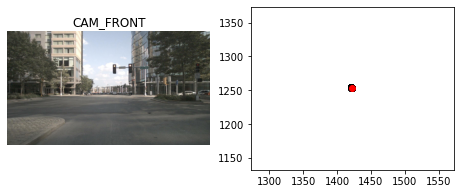

-----------------------------------------------------------------------------
Sample 2/41.  Location: boston-seaport


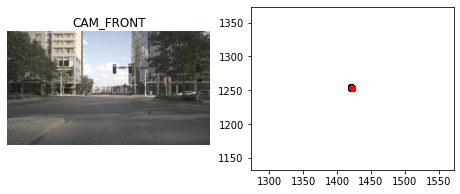

-----------------------------------------------------------------------------
Sample 3/41.  Location: boston-seaport


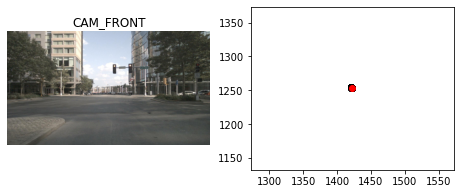

-----------------------------------------------------------------------------
Sample 4/41.  Location: boston-seaport


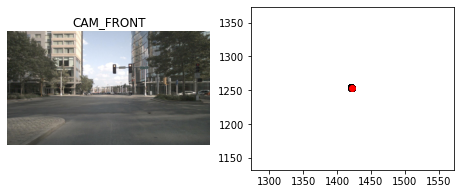

-----------------------------------------------------------------------------
Sample 5/41.  Location: boston-seaport


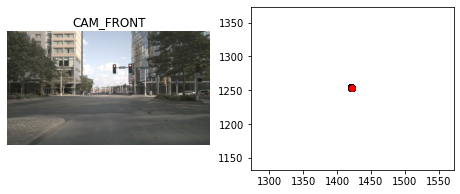

-----------------------------------------------------------------------------
Sample 6/41.  Location: boston-seaport


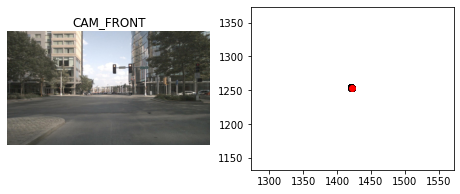

-----------------------------------------------------------------------------
Sample 7/41.  Location: boston-seaport


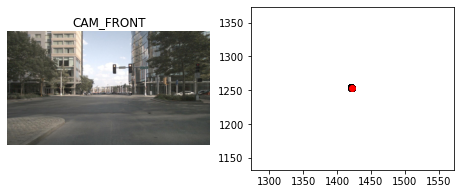

-----------------------------------------------------------------------------
Sample 8/41.  Location: boston-seaport


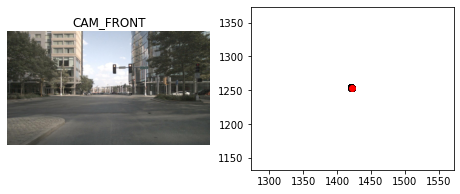

-----------------------------------------------------------------------------
Sample 9/41.  Location: boston-seaport


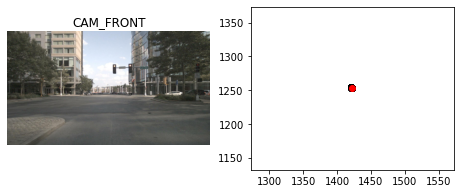

-----------------------------------------------------------------------------
Sample 10/41.  Location: boston-seaport


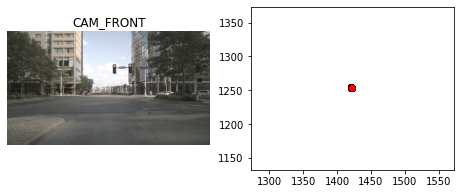

-----------------------------------------------------------------------------
Sample 11/41.  Location: boston-seaport


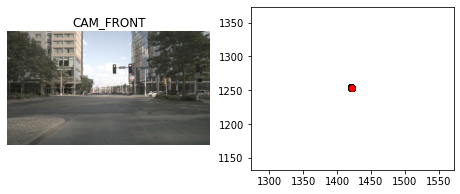

-----------------------------------------------------------------------------
Sample 12/41.  Location: boston-seaport


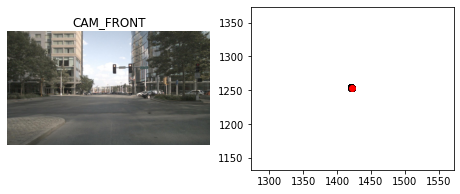

-----------------------------------------------------------------------------
Sample 13/41.  Location: boston-seaport


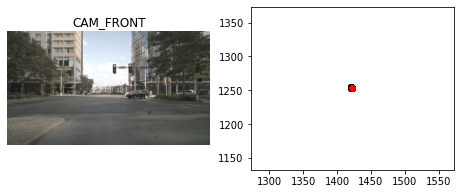

-----------------------------------------------------------------------------
Sample 14/41.  Location: boston-seaport


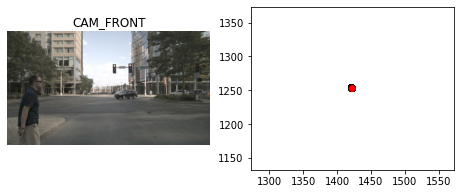

-----------------------------------------------------------------------------
Sample 15/41.  Location: boston-seaport


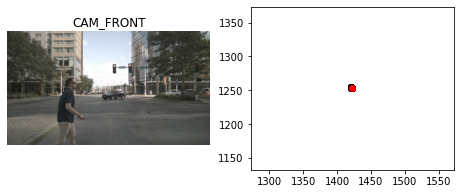

-----------------------------------------------------------------------------
Sample 16/41.  Location: boston-seaport


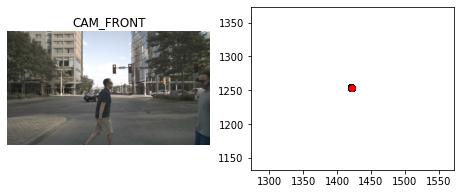

-----------------------------------------------------------------------------
Sample 17/41.  Location: boston-seaport


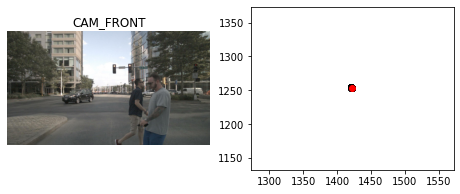

-----------------------------------------------------------------------------
Sample 18/41.  Location: boston-seaport


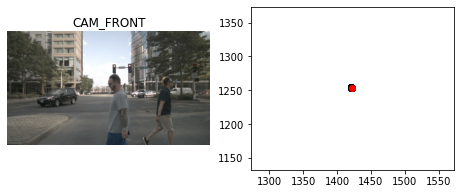

-----------------------------------------------------------------------------
Sample 19/41.  Location: boston-seaport


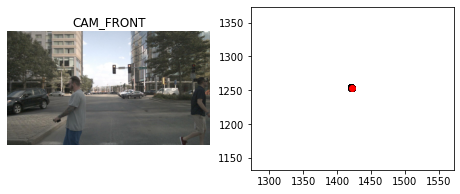

-----------------------------------------------------------------------------
Sample 20/41.  Location: boston-seaport


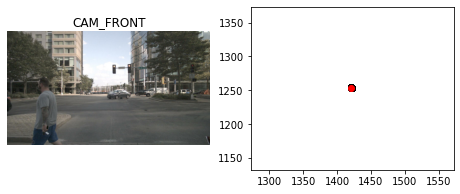

-----------------------------------------------------------------------------
Sample 21/41.  Location: boston-seaport


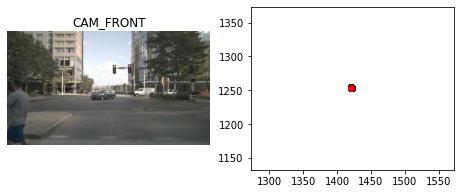

-----------------------------------------------------------------------------
Sample 22/41.  Location: boston-seaport


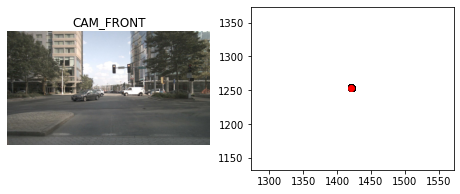

-----------------------------------------------------------------------------
Sample 23/41.  Location: boston-seaport


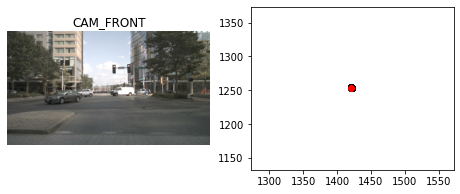

-----------------------------------------------------------------------------
Sample 24/41.  Location: boston-seaport


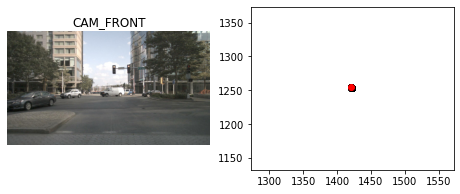

-----------------------------------------------------------------------------
Sample 25/41.  Location: boston-seaport


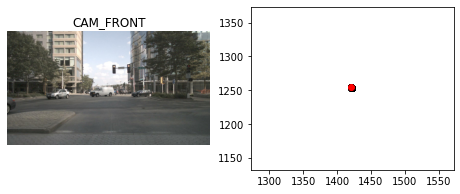

-----------------------------------------------------------------------------
Sample 26/41.  Location: boston-seaport


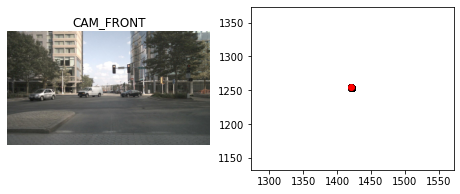

-----------------------------------------------------------------------------
Sample 27/41.  Location: boston-seaport


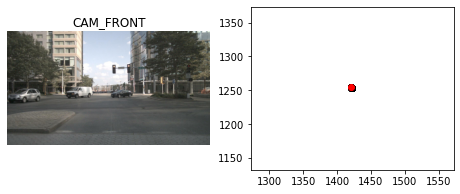

-----------------------------------------------------------------------------
Sample 28/41.  Location: boston-seaport


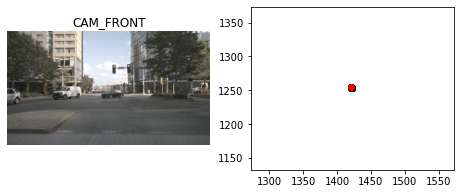

-----------------------------------------------------------------------------
Sample 29/41.  Location: boston-seaport


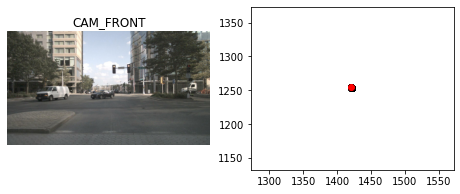

-----------------------------------------------------------------------------
Sample 30/41.  Location: boston-seaport


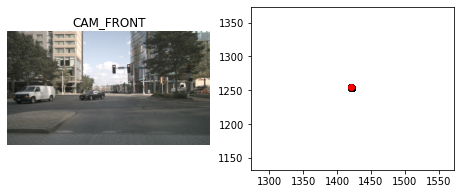

-----------------------------------------------------------------------------
Sample 31/41.  Location: boston-seaport


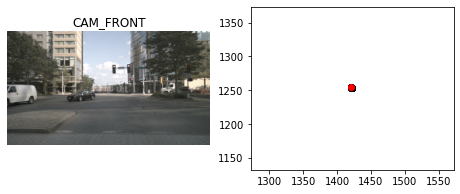

-----------------------------------------------------------------------------
Sample 32/41.  Location: boston-seaport


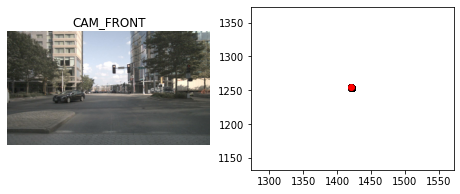

-----------------------------------------------------------------------------
Sample 33/41.  Location: boston-seaport


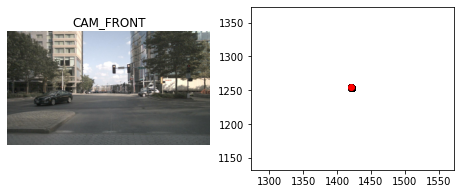

-----------------------------------------------------------------------------
Sample 34/41.  Location: boston-seaport


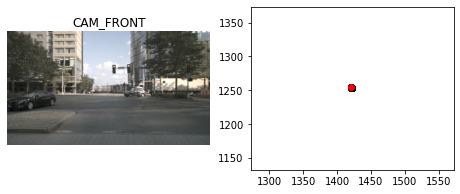

-----------------------------------------------------------------------------
Sample 35/41.  Location: boston-seaport


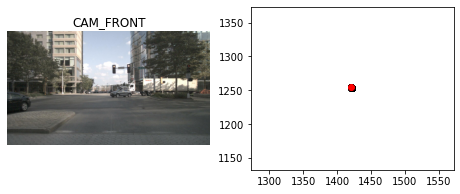

-----------------------------------------------------------------------------
Sample 36/41.  Location: boston-seaport


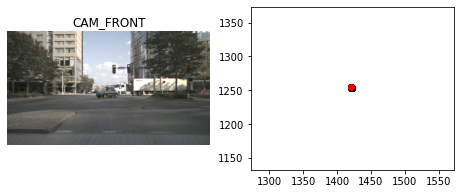

-----------------------------------------------------------------------------
Sample 37/41.  Location: boston-seaport


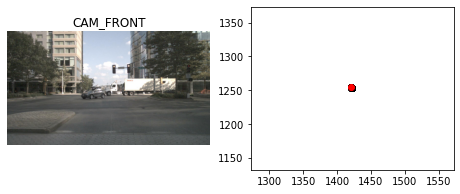

-----------------------------------------------------------------------------
Sample 38/41.  Location: boston-seaport


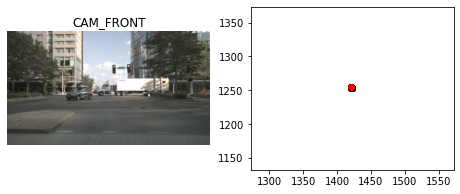

-----------------------------------------------------------------------------
Sample 39/41.  Location: boston-seaport


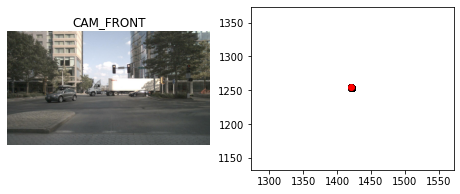

-----------------------------------------------------------------------------
Sample 40/41.  Location: boston-seaport


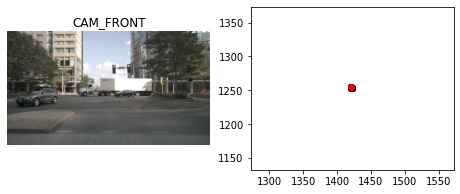

-----------------------------------------------------------------------------
Sample 41/41.  Location: boston-seaport


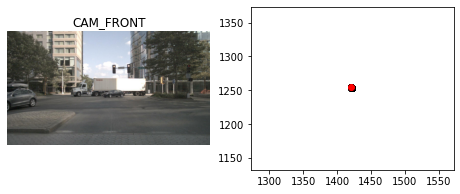

-----------------------------------------------------------------------------


In [11]:
scene_token = scenes_with_crosswalk[6]
scene = nusc.get('scene', scene_token)
location = nusc.get('log',scene['log_token'])['location']    
sample = nusc.get('sample', scene['first_sample_token'])
sample_counter = 0
number_samples = scene['nbr_samples']

pose_array = nbutils.get_ego_positions_from_scene(nusc, scene)

while sample != '':
    sample_counter += 1
    sensor = 'CAM_FRONT'
    cam_front_data = nusc.get('sample_data', sample['data'][sensor])
    print("Sample %d/%d.  Location: %s"%(sample_counter, number_samples, location))
    fig, axs = plt.subplots(1, 2, figsize=[8,3])
    #     nusc.render_sample_data(cam_fleft_data['token'], with_anns=False, ax = axs[0])
    nusc.render_sample_data(cam_front_data['token'], with_anns=False, ax = axs[0])
    
    axs[1].scatter(pose_array[0,:], pose_array[1,:], color='black')
    axs[1].scatter(pose_array[0, sample_counter - 1], pose_array[1, sample_counter -1], color='red')
    axs[1].axis('equal')
    axs[1].set_xlim([pose_array[0,0]-150,pose_array[0,0]+150])
    axs[1].set_ylim([pose_array[1,0]-150,pose_array[1,0]+150])

    plt.show()
    print("-----------------------------------------------------------------------------")
    if sample['next'] == '':
        break
    sample = nusc.get('sample', sample['next'])

### Example with movement

Sample 1/40.  Location: boston-seaport


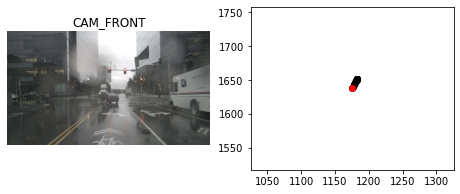

-----------------------------------------------------------------------------
Sample 2/40.  Location: boston-seaport


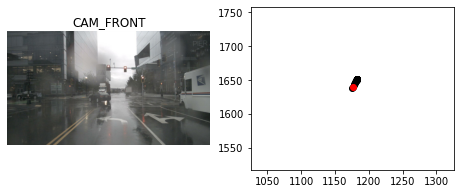

-----------------------------------------------------------------------------
Sample 3/40.  Location: boston-seaport


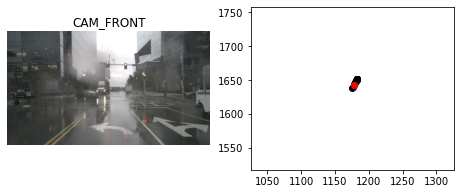

-----------------------------------------------------------------------------
Sample 4/40.  Location: boston-seaport


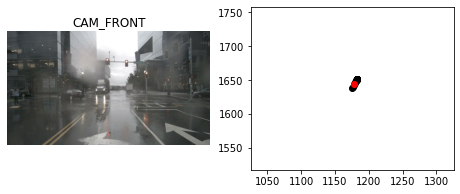

-----------------------------------------------------------------------------
Sample 5/40.  Location: boston-seaport


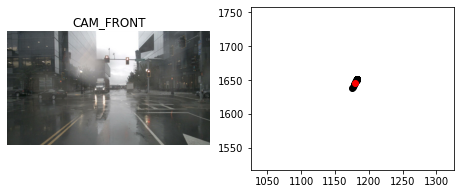

-----------------------------------------------------------------------------
Sample 6/40.  Location: boston-seaport


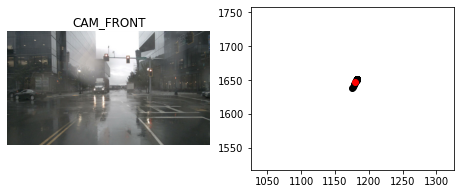

-----------------------------------------------------------------------------
Sample 7/40.  Location: boston-seaport


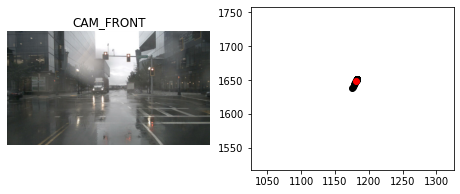

-----------------------------------------------------------------------------
Sample 8/40.  Location: boston-seaport


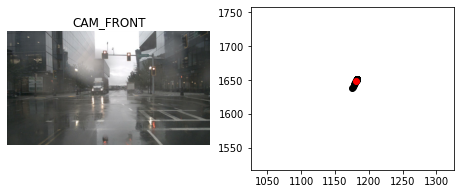

-----------------------------------------------------------------------------
Sample 9/40.  Location: boston-seaport


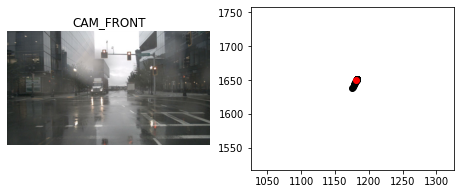

-----------------------------------------------------------------------------
Sample 10/40.  Location: boston-seaport


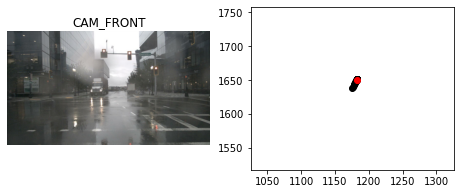

-----------------------------------------------------------------------------
Sample 11/40.  Location: boston-seaport


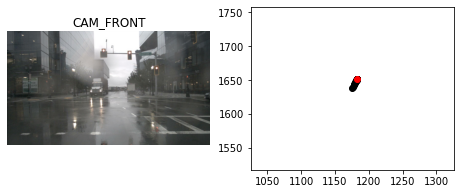

-----------------------------------------------------------------------------
Sample 12/40.  Location: boston-seaport


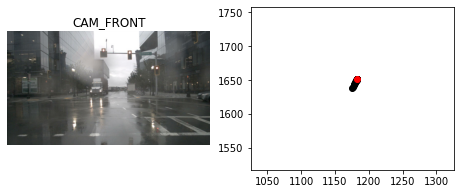

-----------------------------------------------------------------------------
Sample 13/40.  Location: boston-seaport


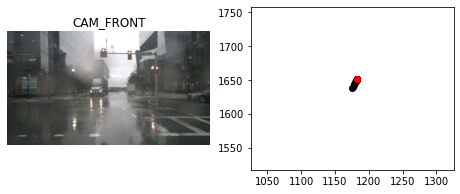

-----------------------------------------------------------------------------
Sample 14/40.  Location: boston-seaport


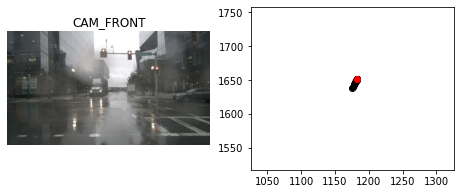

-----------------------------------------------------------------------------
Sample 15/40.  Location: boston-seaport


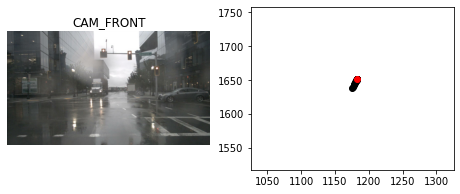

-----------------------------------------------------------------------------
Sample 16/40.  Location: boston-seaport


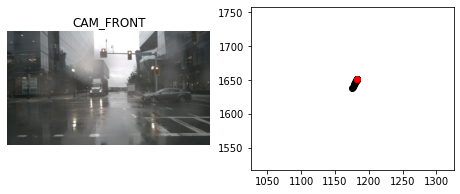

-----------------------------------------------------------------------------
Sample 17/40.  Location: boston-seaport


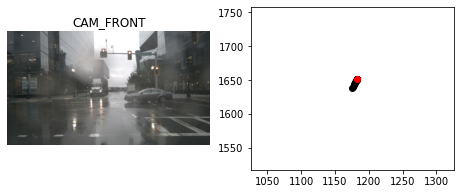

-----------------------------------------------------------------------------
Sample 18/40.  Location: boston-seaport


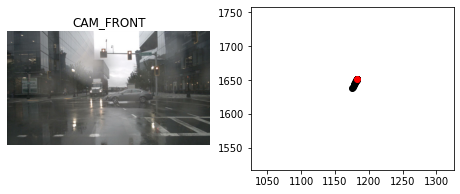

-----------------------------------------------------------------------------
Sample 19/40.  Location: boston-seaport


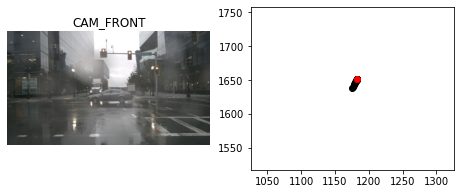

-----------------------------------------------------------------------------
Sample 20/40.  Location: boston-seaport


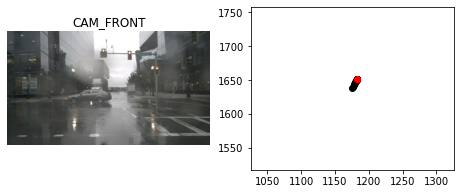

-----------------------------------------------------------------------------
Sample 21/40.  Location: boston-seaport


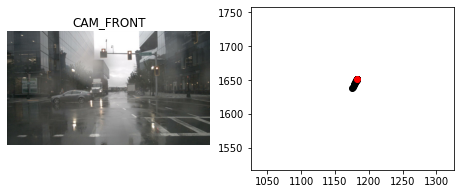

-----------------------------------------------------------------------------
Sample 22/40.  Location: boston-seaport


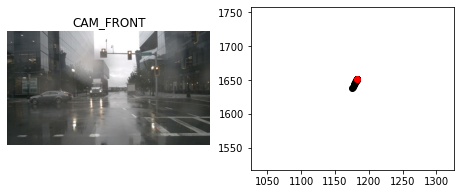

-----------------------------------------------------------------------------
Sample 23/40.  Location: boston-seaport


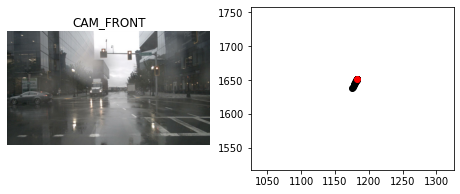

-----------------------------------------------------------------------------
Sample 24/40.  Location: boston-seaport


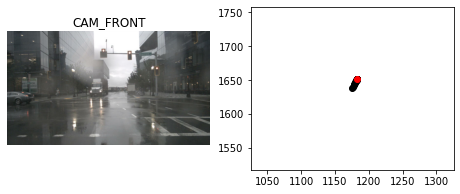

-----------------------------------------------------------------------------
Sample 25/40.  Location: boston-seaport


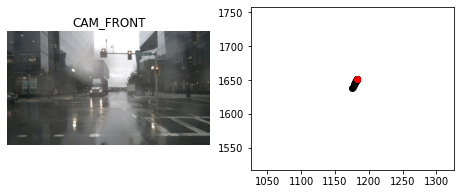

-----------------------------------------------------------------------------
Sample 26/40.  Location: boston-seaport


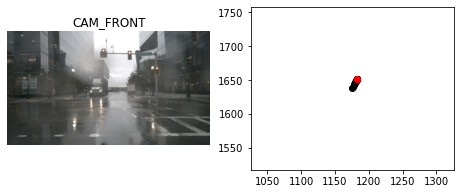

-----------------------------------------------------------------------------
Sample 27/40.  Location: boston-seaport


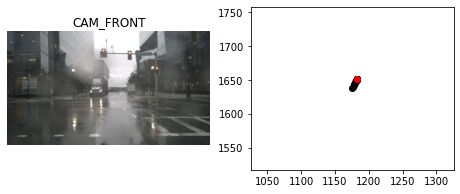

-----------------------------------------------------------------------------
Sample 28/40.  Location: boston-seaport


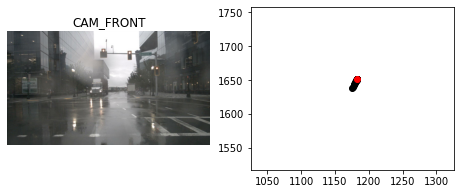

-----------------------------------------------------------------------------
Sample 29/40.  Location: boston-seaport


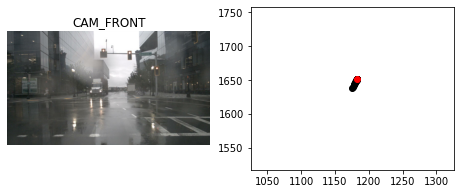

-----------------------------------------------------------------------------
Sample 30/40.  Location: boston-seaport


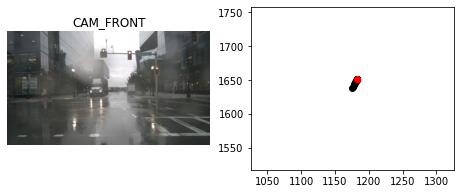

-----------------------------------------------------------------------------
Sample 31/40.  Location: boston-seaport


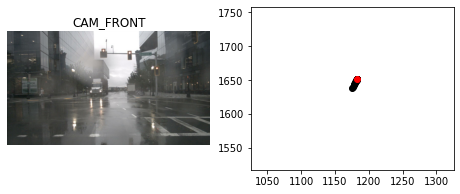

-----------------------------------------------------------------------------
Sample 32/40.  Location: boston-seaport


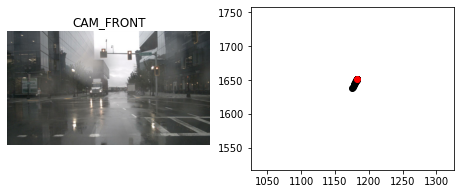

-----------------------------------------------------------------------------
Sample 33/40.  Location: boston-seaport


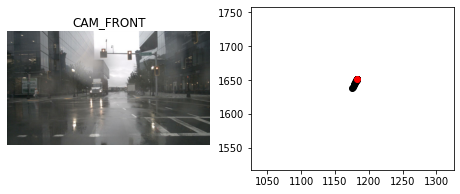

-----------------------------------------------------------------------------
Sample 34/40.  Location: boston-seaport


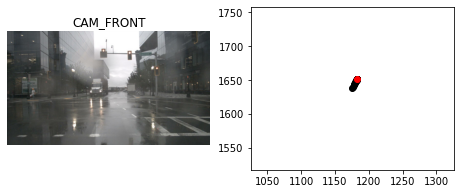

-----------------------------------------------------------------------------
Sample 35/40.  Location: boston-seaport


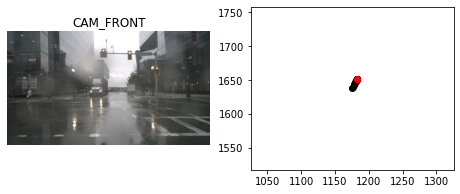

-----------------------------------------------------------------------------
Sample 36/40.  Location: boston-seaport


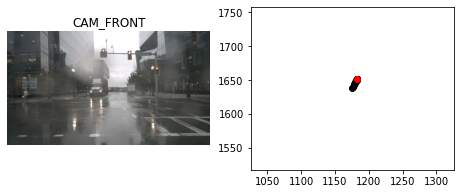

-----------------------------------------------------------------------------
Sample 37/40.  Location: boston-seaport


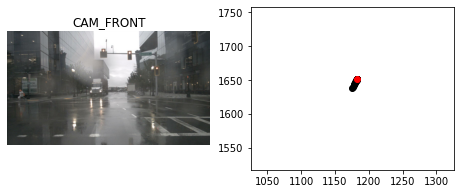

-----------------------------------------------------------------------------
Sample 38/40.  Location: boston-seaport


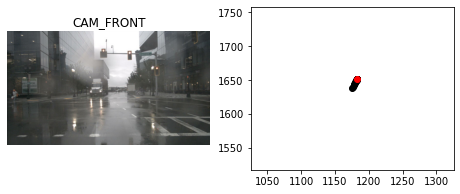

-----------------------------------------------------------------------------
Sample 39/40.  Location: boston-seaport


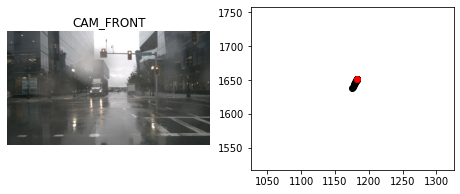

-----------------------------------------------------------------------------
Sample 40/40.  Location: boston-seaport


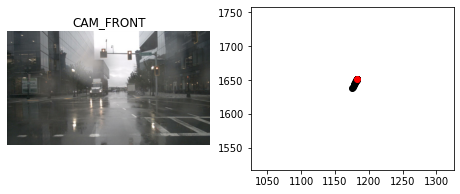

-----------------------------------------------------------------------------


In [8]:
scene_token = scenes_with_crosswalk[1]
scene = nusc.get('scene', scene_token)
location = nusc.get('log',scene['log_token'])['location']    
sample = nusc.get('sample', scene['first_sample_token'])
sample_counter = 0
number_samples = scene['nbr_samples']

pose_array = nbutils.get_ego_positions_from_scene(nusc, scene)

while sample != '':
    sample_counter += 1
    sensor = 'CAM_FRONT'
    cam_front_data = nusc.get('sample_data', sample['data'][sensor])
    print("Sample %d/%d.  Location: %s"%(sample_counter, number_samples, location))
    fig, axs = plt.subplots(1, 2, figsize=[8,3])
    #     nusc.render_sample_data(cam_fleft_data['token'], with_anns=False, ax = axs[0])
    nusc.render_sample_data(cam_front_data['token'], with_anns=False, ax = axs[0])
    
    axs[1].scatter(pose_array[0,:], pose_array[1,:], color='black')
    axs[1].scatter(pose_array[0, sample_counter - 1], pose_array[1, sample_counter -1], color='red')
    axs[1].axis('equal')
    axs[1].set_xlim([pose_array[0,0]-150,pose_array[0,0]+150])
    axs[1].set_ylim([pose_array[1,0]-150,pose_array[1,0]+150])

    plt.show()
    print("-----------------------------------------------------------------------------")
    if sample['next'] == '':
        break
    sample = nusc.get('sample', sample['next'])